<h1 align="center"> World_Cup-2019 </h1> 

In [1]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport   ##For Exploratory Data Analysis.

#To Surpress Future Warnings
import warnings
warnings.filterwarnings('ignore')

#For Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as pltly
import chart_studio.plotly as py
import plotly.graph_objs as go

#### ***OBJECTIVES***

**We try to accomplish the following objectives in this analysis:-**

1. The top 3 Batsman for each country (Based on Runs)
2. The highest scoring Indian batsmen against each country
3. The top 3 Bowlers for each country (Based on Wickets).
4. Which Countries have Best Bowlers? (Based on different criterias)
5. Does England have a ground advantage?
6. Win-Loss Analysis of each country
7. Win pattern in different grounds.


> **INDIAN CRICKET TEAM-2019**

8. Team INDIA
9. Threatening Players in each team. (Against India)
 - Batsmen
 - Bowler

In [2]:
#Datasets

Batsman = pd.read_csv('Batsman.csv')
Bowler = pd.read_csv('Bowler.csv')
Ground = pd.read_csv('Ground.csv')
Match_Result = pd.read_csv('ODI_Match_Results.csv')
Match_Total = pd.read_csv('ODI_Match_Totals.csv')
Players = pd.read_csv('WC_players.csv')

## Initial preparation

##### We know that the world cup 2019 is being held in England. Following are the names of the Grounds:
- The Oval, London
- Trent Bridge, Nottingham
- Sophia Gardens, Cardiff
- County Ground, Bristol
- Rose Bowl, Southampton
- County Ground, Taunton
- Old Trafford, Manchester
- Edgbaston, Birmingham
- Headingley, Leeds
- Lord’s, London
- Riverside Ground, Chester-le-Street

In [3]:
Pitches = ['The Oval, London','Trent Bridge, Nottingham','Sophia Gardens, Cardiff','County Ground, Bristol',
           'Rose Bowl, Southampton','County Ground, Taunton','Old Trafford, Manchester','Edgbaston, Birmingham',
           'Headingley, Leeds',"Lord's, London",'Riverside Ground, Chester-le-Street']

In [4]:
England_Pitches = []
grounds = Match_Total['Ground']
for i in grounds:
    for j in Pitches:
        if i in j:
            England_Pitches.append((i,j))

In [5]:
Ground_Name = dict(set(England_Pitches))
def Pitch_Name(value):
    return Ground_Name[value]
Ground_Name

{'Cardiff': 'Sophia Gardens, Cardiff',
 "Lord's": "Lord's, London",
 'Chester-le-Street': 'Riverside Ground, Chester-le-Street',
 'The Oval': 'The Oval, London',
 'Manchester': 'Old Trafford, Manchester',
 'Leeds': 'Headingley, Leeds',
 'Bristol': 'County Ground, Bristol',
 'Southampton': 'Rose Bowl, Southampton',
 'Nottingham': 'Trent Bridge, Nottingham',
 'Birmingham': 'Edgbaston, Birmingham'}

##### We will make our analysis based on these Pitches.

# Cleaning Batsman DataSet 

In [6]:
Batsman.head()

,Unnamed: 0,Bat1,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
0,1,DNB,-,-,-,-,-,v India,Nagpur,18 Dec 2009,ODI # 2933,Oshane Thomas,49619
1,2,DNB,-,-,-,-,-,v India,Kolkata,24 Dec 2009,ODI # 2935,Oshane Thomas,49619
2,3,DNB,-,-,-,-,-,v India,Delhi,27 Dec 2009,ODI # 2936,Oshane Thomas,49619
3,4,DNB,-,-,-,-,-,v Bangladesh,Dhaka,4 Jan 2010,ODI # 2937,Oshane Thomas,49619
4,5,DNB,-,-,-,-,-,v India,Dhaka,5 Jan 2010,ODI # 2938,Oshane Thomas,49619


In [7]:
Batsman.drop(columns = 'Unnamed: 0',axis = 1,inplace = True)
Batsman.head()

,Bat1,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
0,DNB,-,-,-,-,-,v India,Nagpur,18 Dec 2009,ODI # 2933,Oshane Thomas,49619
1,DNB,-,-,-,-,-,v India,Kolkata,24 Dec 2009,ODI # 2935,Oshane Thomas,49619
2,DNB,-,-,-,-,-,v India,Delhi,27 Dec 2009,ODI # 2936,Oshane Thomas,49619
3,DNB,-,-,-,-,-,v Bangladesh,Dhaka,4 Jan 2010,ODI # 2937,Oshane Thomas,49619
4,DNB,-,-,-,-,-,v India,Dhaka,5 Jan 2010,ODI # 2938,Oshane Thomas,49619


In [8]:
#Boolean indexing :- ***Boolean indexing helps us to select the data from the DataFrames using a boolean vector.***
 
Batsman = Batsman[Batsman['Bat1'] != 'DNB'] 
Batsman = Batsman[Batsman['Bat1'] != 'TDNB']
Batsman = Batsman[Batsman['Bat1'] != 'absent']

### These 'DNB','TDNB' and 'absent' values are all found out previously using Batsman.unique().. I will not be using it.

Batsman.head()

,Bat1,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
5,0*,0,8,0.00,0,0,v India,Dhaka,10 Jan 2010,ODI # 2941,Oshane Thomas,49619
6,0*,0,0,-,0,0,v England,The Oval,28 Jun 2011,ODI # 3165,Oshane Thomas,49619
9,1*,1,3,33.33,0,0,v England,Nottingham,6 Jul 2011,ODI # 3169,Oshane Thomas,49619
10,0*,0,2,0.00,0,0,v Australia,Pallekele,10 Aug 2011,ODI # 3175,Oshane Thomas,49619
11,0,0,2,0.00,0,0,v Pakistan,Dubai (DSC),11 Nov 2011,ODI # 3212,Oshane Thomas,49619


In [9]:
Batsman.replace('-',0,inplace = True)
Batsman.drop(columns = 'Bat1',axis = 1,inplace = True)
Batsman = Batsman.astype({'SR':'float64','Runs':'int64','BF':'int64','4s':'int64','6s':'int64'})

In [10]:
Batsman = Batsman[Batsman['Runs'] != 0]  #We dont want players who has scored nothing.
Batsman = Batsman[Batsman['BF'] > 6]     ##We only want players who has faced at least 6 balls.

Batsman.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
18,2,11,18.18,0,0,v Pakistan,Abu Dhabi,25 Dec 2013,ODI # 3448,Oshane Thomas,49619
31,7,17,41.17,0,0,v New Zealand,Christchurch,14 Feb 2015,ODI # 3599,Oshane Thomas,49619
41,8,9,88.88,0,0,v New Zealand,Christchurch,26 Dec 2015,ODI # 3714,Oshane Thomas,49619
43,7,8,87.50,0,0,v England,Nottingham,21 Jun 2016,ODI # 3751,Oshane Thomas,49619
47,10,23,43.47,1,0,v England,Cardiff,2 Jul 2016,ODI # 3758,Oshane Thomas,49619


In [11]:
ProfileReport(Batsman)

In [12]:
Bat = Batsman.copy()
Bat.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
18,2,11,18.18,0,0,v Pakistan,Abu Dhabi,25 Dec 2013,ODI # 3448,Oshane Thomas,49619
31,7,17,41.17,0,0,v New Zealand,Christchurch,14 Feb 2015,ODI # 3599,Oshane Thomas,49619
41,8,9,88.88,0,0,v New Zealand,Christchurch,26 Dec 2015,ODI # 3714,Oshane Thomas,49619
43,7,8,87.50,0,0,v England,Nottingham,21 Jun 2016,ODI # 3751,Oshane Thomas,49619
47,10,23,43.47,1,0,v England,Cardiff,2 Jul 2016,ODI # 3758,Oshane Thomas,49619


In [13]:
#Selecting Pitches that are there in England.
Stadiums = [item[0] for item in set(England_Pitches)]
Bat = Bat[Bat['Ground'].isin(Stadiums)]

In [14]:
Bat = Bat.groupby(["Ground","Batsman"]).sum().reset_index()

Since our Bat DataFrame doesnt have the details about the country name of each player, we add that using out Players DataFrame.

In [15]:
Players.head(3)

,Player,ID,Country
0,Gulbadin Naib (c),352048,Afghanistan
1,Rashid Khan (vc),793463,Afghanistan
2,Aftab Alam,440963,Afghanistan


In [16]:
#To check whether each element in Bat['Player_ID'] is contained in Players['ID'].
Bat = Bat[Bat['Player_ID'].isin(Players['ID'])] 
Bat.head()

,Ground,Batsman,Runs,BF,SR,4s,6s,Player_ID
1,Birmingham,Adil Rashid,69,50,138.00,7,2,244497
7,Birmingham,Chris Morris,28,45,62.22,1,0,439952
8,Birmingham,Chris Woakes,10,18,55.55,0,0,247235
14,Birmingham,Fakhar Zaman,31,23,134.78,6,0,512191
18,Birmingham,James Neesham,6,10,60.00,0,0,355269


In [17]:
Batsman_ID = Bat[["Player_ID","Batsman"]].drop_duplicates() #Return DataFrame with duplicate rows removed.

In [18]:
#To add a column called country.
Player_ID = list(Bat.merge(Batsman_ID,how = "left",on = "Batsman")["Player_ID_y"].astype("int"))
Bat["Player_ID"] = Player_ID

Players.columns = ["Player", "Player_ID","Country"]
Player_Country = list(Bat.merge(Players,how = "left",on = "Player_ID")["Country"])
Bat["Country"] = Player_Country

In [19]:
Best_Batsman_Overall = Bat[(Bat['SR']> 80) & (Bat['Runs'] >  30)].sort_values(by = 'Runs',ascending = False)
Best_Batsman_Overall.head()

,Ground,Batsman,Runs,BF,SR,4s,6s,Player_ID,Country
346,Southampton,Martin Guptill,189,155,121.93,19,2,226492,NewZealand
374,The Oval,Evin Lewis,176,130,135.38,17,7,431901,WestIndies
64,Bristol,Imam-ul-Haq,151,131,115.26,16,1,568276,Pakistan
332,Southampton,Fakhar Zaman,138,106,130.18,12,4,512191,Pakistan
304,Nottingham,Rohit Sharma,137,114,120.17,15,4,34102,India


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

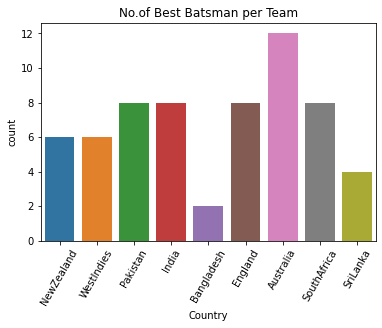

In [20]:
sns.countplot(Best_Batsman_Overall["Country"])
plt.title("No.of Best Batsman per Team")
plt.xticks(rotation = 60)

In [21]:
Bat.head()

,Ground,Batsman,Runs,BF,SR,4s,6s,Player_ID,Country
1,Birmingham,Adil Rashid,69,50,138.00,7,2,244497,England
7,Birmingham,Chris Morris,28,45,62.22,1,0,439952,SouthAfrica
8,Birmingham,Chris Woakes,10,18,55.55,0,0,247235,England
14,Birmingham,Fakhar Zaman,31,23,134.78,6,0,512191,Pakistan
18,Birmingham,James Neesham,6,10,60.00,0,0,355269,NewZealand


In [22]:
Bat['Country'].unique()

array(['England', 'SouthAfrica', 'Pakistan', 'NewZealand', 'SriLanka',
       'India', 'Australia', 'Bangladesh', 'WestIndies'], dtype=object)

## 1. The top 3 Batsman for each country (Based on Runs).

In [23]:
grup = Bat.groupby('Country')

**INDIA**

In [24]:
India_Bat = grup.get_group('India')
India_Bat.set_index('Batsman',inplace = True)

In [25]:
India_Bat.drop(columns = 'Ground', axis = 1,inplace = True)
India_Bat = India_Bat.groupby("Batsman").sum() #Groups each batsman and then takes their sum.

In [26]:
India_Bat.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Rohit Sharma,154,158,188.97,17,4,102306
Dinesh Karthik,135,170,407.50,17,1,180270
Ravindra Jadeja,132,102,393.27,12,4,704025


**Pakistan**

In [27]:
Pakistan = grup.get_group('Pakistan')
Pakistan.set_index('Batsman',inplace = True)

In [28]:
Pakistan.drop(columns = 'Ground', axis = 1,inplace = True)
Pakistan = Pakistan.groupby("Batsman").sum() 

In [29]:
Pakistan.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Imam-ul-Haq,234,263,286.56,24,1,2273104
Fakhar Zaman,226,179,378.96,23,6,1536573
Imad Wasim,212,192,833.93,21,4,1594306


**NewZealand**

In [30]:
NewZealand = grup.get_group('NewZealand')
NewZealand.set_index('Batsman',inplace = True)

In [31]:
NewZealand.drop(columns = 'Ground', axis = 1,inplace = True)
NewZealand = NewZealand.groupby("Batsman").sum() 

In [32]:
NewZealand.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Martin Guptill,409,405,390.03,39,8,905968
Kane Williamson,143,153,182.60,17,1,555812
Mitchell Santner,80,46,499.18,8,4,1508142


**SouthAfrica**

In [33]:
SouthAfrica = grup.get_group('SouthAfrica')
SouthAfrica.set_index('Batsman',inplace = True)

In [34]:
SouthAfrica.drop(columns = 'Ground', axis = 1,inplace = True)
SouthAfrica = SouthAfrica.groupby("Batsman").sum() 

In [35]:
SouthAfrica.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Hashim Amla,170,183,186.70,17,1,87812
Quinton de Kock,170,204,288.11,17,0,1516572
David Miller,120,90,380.24,6,6,965331


**SriLanka**

In [36]:
SriLanka = grup.get_group('SriLanka')
SriLanka.set_index('Batsman',inplace = True)

In [37]:
SriLanka.drop(columns = 'Ground', axis = 1,inplace = True)
SriLanka = SriLanka.groupby("Batsman").sum() 

In [38]:
SriLanka.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Lahiru Thirimanne,150,254,310.72,9,2,1506180
Angelo Mathews,132,132,322.62,12,1,149292
Jeevan Mendis,93,132,259.91,6,0,198800


**Bangladesh**

In [39]:
Bangladesh = grup.get_group('Bangladesh')
Bangladesh.set_index('Batsman',inplace = True)

In [40]:
Bangladesh.drop(columns = 'Ground', axis = 1,inplace = True)
Bangladesh = Bangladesh.groupby("Batsman").sum() 

In [41]:
Bangladesh.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Mahmudullah,138,159,295.76,8,3,224100
Shakib Al Hasan,134,151,154.68,13,1,112286
Mushfiqur Rahim,97,137,235.15,6,2,168087


**Australia**

In [42]:
Australia = grup.get_group('Australia')
Australia.set_index('Batsman',inplace = True)

In [43]:
Australia.drop(columns = 'Ground', axis = 1,inplace = True)
Australia = Australia.groupby("Batsman").sum() 

In [44]:
Australia.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Glenn Maxwell,216,182,694.58,23,6,1950156
Shaun Marsh,216,214,454.44,13,8,33415
Aaron Finch,161,184,336.39,14,5,21336


**WestIndies**

In [45]:
WestIndies = grup.get_group('WestIndies')
WestIndies.set_index('Batsman',inplace = True)

In [46]:
WestIndies.drop(columns = 'Ground', axis = 1,inplace = True)
WestIndies = WestIndies.groupby("Batsman").sum() 

In [47]:
WestIndies.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Evin Lewis,200,152,376.45,18,9,1295703
Jason Holder,152,121,379.19,10,7,1174455
Shai Hope,138,188,317.18,14,1,2325516


**England**

In [48]:
England = grup.get_group('England')
England.set_index('Batsman',inplace = True)

In [49]:
England.drop(columns = 'Ground', axis = 1,inplace = True)
England = England.groupby("Batsman").sum()

In [50]:
England.nlargest(3,'Runs')

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Jason Roy,175,140,257.89,16,4,596876
Adil Rashid,92,70,371.33,11,2,733491
Moeen Ali,83,81,185.61,4,3,17834


## 2. The highest scoring Indian batsmen against each country.

In [51]:
#We remove the countries that we dont need in this particular study.

Batsman = Batsman[Batsman['Opposition'] != 'v Zimbabwe']
Batsman = Batsman[Batsman['Opposition'] != 'v Ireland']
Batsman = Batsman[Batsman['Opposition'] != 'v U.A.E.']
Batsman = Batsman[Batsman['Opposition'] != 'v Afghanistan']
Batsman = Batsman[Batsman['Opposition'] != 'v Scotland']
Batsman = Batsman[Batsman['Opposition'] != 'v P.N.G.']

Batsman = Batsman[Batsman['Opposition'] != 'v Canada']
Batsman = Batsman[Batsman['Opposition'] != 'v Netherlands']
Batsman = Batsman[Batsman['Opposition'] != 'v Kenya']
Batsman = Batsman[Batsman['Opposition'] != 'v Asia XI']
Batsman = Batsman[Batsman['Opposition'] != 'v Hong Kong']
Batsman = Batsman[Batsman['Opposition'] != 'v Bermuda']
Batsman = Batsman[Batsman['Opposition'] != 'v Africa XI']

In [52]:
Batsman.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
18,2,11,18.18,0,0,v Pakistan,Abu Dhabi,25 Dec 2013,ODI # 3448,Oshane Thomas,49619
31,7,17,41.17,0,0,v New Zealand,Christchurch,14 Feb 2015,ODI # 3599,Oshane Thomas,49619
41,8,9,88.88,0,0,v New Zealand,Christchurch,26 Dec 2015,ODI # 3714,Oshane Thomas,49619
43,7,8,87.50,0,0,v England,Nottingham,21 Jun 2016,ODI # 3751,Oshane Thomas,49619
47,10,23,43.47,1,0,v England,Cardiff,2 Jul 2016,ODI # 3758,Oshane Thomas,49619


In [53]:
Batsman['Opposition'].unique()

array(['v Pakistan', 'v New Zealand', 'v England', 'v South Africa',
       'v Bangladesh', 'v India', 'v Australia', 'v Sri Lanka',
       'v West Indies'], dtype=object)

In [54]:
India_Vs = Batsman[Batsman['Player_ID'].isin(Players['Player_ID'])] 
India_Vs.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
91,49,46,106.52,2,3,v England,Chennai,17 Mar 2011,ODI # 3135,Andre Russell,276298
94,3,9,33.33,0,0,v Pakistan,Bridgetown,28 Apr 2011,ODI # 3154,Andre Russell,276298
95,92,64,143.75,8,5,v India,North Sound,11 Jun 2011,ODI # 3161,Andre Russell,276298
96,25,14,178.57,3,1,v India,North Sound,13 Jun 2011,ODI # 3162,Andre Russell,276298
101,22,20,110.00,2,1,v India,Cuttack,29 Nov 2011,ODI # 3217,Andre Russell,276298


In [55]:
Batsman_ID = India_Vs[["Player_ID","Batsman"]].drop_duplicates()

In [56]:
#To add a column called country.
Player_ID = list(India_Vs.merge(Batsman_ID,how = "left",on = "Batsman")["Player_ID_y"].astype("int"))
India_Vs["Player_ID"] = Player_ID

Players.columns = ["Player", "Player_ID","Country"]
Player_Country = list(India_Vs.merge(Players,how = "left",on = "Player_ID")["Country"])
India_Vs["Country"] = Player_Country

In [57]:
India_Vs.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID,Country
91,49,46,106.52,2,3,v England,Chennai,17 Mar 2011,ODI # 3135,Andre Russell,276298,WestIndies
94,3,9,33.33,0,0,v Pakistan,Bridgetown,28 Apr 2011,ODI # 3154,Andre Russell,276298,WestIndies
95,92,64,143.75,8,5,v India,North Sound,11 Jun 2011,ODI # 3161,Andre Russell,276298,WestIndies
96,25,14,178.57,3,1,v India,North Sound,13 Jun 2011,ODI # 3162,Andre Russell,276298,WestIndies
101,22,20,110.00,2,1,v India,Cuttack,29 Nov 2011,ODI # 3217,Andre Russell,276298,WestIndies


In [58]:
grp = India_Vs.groupby('Country')
India = grp.get_group('India')
India.set_index('Country',inplace = True)
India = India.groupby(['Opposition',"Batsman"]).sum()

In [59]:
India

Runs    BF       SR   4s  6s  Player_ID
Opposition    Batsman                                                   
v Australia   Bhuvneshwar Kumar   155   185   500.73   15   2    1956096
              Dinesh Karthik       37    35   235.71    2   0      60090
              Hardik Pandya       222   204   413.50   13  12    2501484
              K. L. Rahul          26    31    83.87    1   0     422108
              Kedar Jadhav        369   419   852.62   39   4    2907160
...                               ...   ...      ...  ...  ..        ...
v West Indies Mohammed Shami       19    17   111.76    2   1     481896
              Ravindra Jadeja     178   259   922.58   14   1    3050775
              Rohit Sharma       1219  1341  2000.14  106  27     818448
              Shikhar Dhawan      772   866  1442.32   96  10     508230
              Virat Kohli        1835  1892  2687.97  188  24    7360258

[89 rows x 6 columns]

In [60]:
India.reset_index(inplace = True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 <a list of 15 Text major ticklabel objects>)

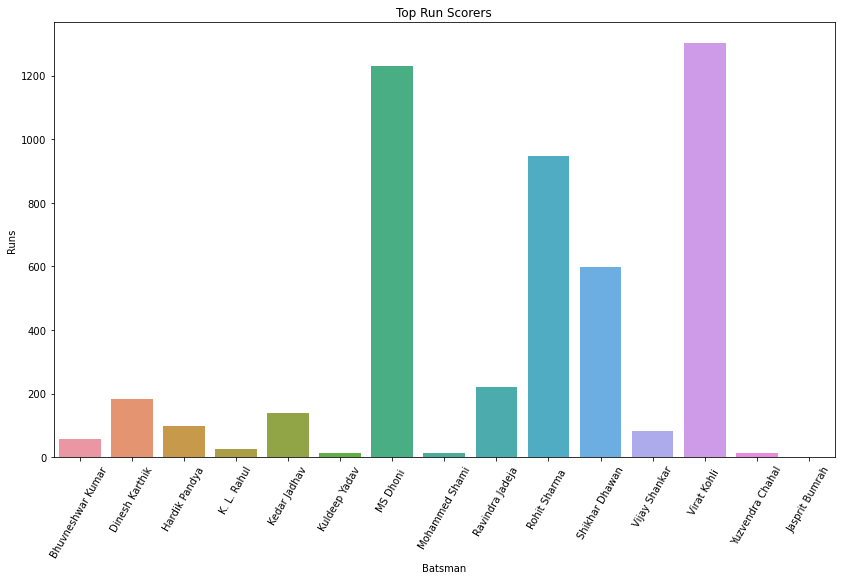

In [61]:
#Graphical representation of the top Indian batsmen.
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = India, ci = None)
plt.title("Top Run Scorers")
plt.xticks(rotation = 60)

### **India Vs West Indies**

In [62]:
WestIndies = India[India['Opposition'] == 'v West Indies']
WestIndies.loc[WestIndies['Runs'].idxmax()].to_frame(name = 'Details')   

,Details
Opposition,v West Indies
Batsman,Virat Kohli
Runs,1835
BF,1892
SR,2687.97
4s,188
6s,24
Player_ID,7360258


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 <a list of 11 Text major ticklabel objects>)

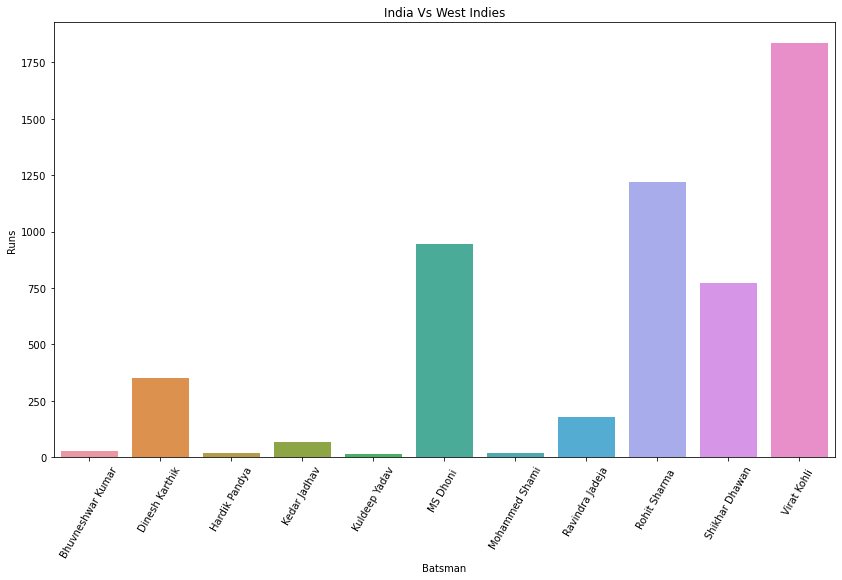

In [63]:
#Graphical representation of the top Indian batsmen against WestIndies
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = WestIndies)
plt.title("India Vs West Indies")
plt.xticks(rotation = 60)

### **India Vs Pakistan**

In [64]:
Pakistan = India[India['Opposition'] == 'v Pakistan']
Pakistan.loc[Pakistan['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v Pakistan
Batsman,MS Dhoni
Runs,1224
BF,1353
SR,2340.79
4s,107
6s,25
Player_ID,786268


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

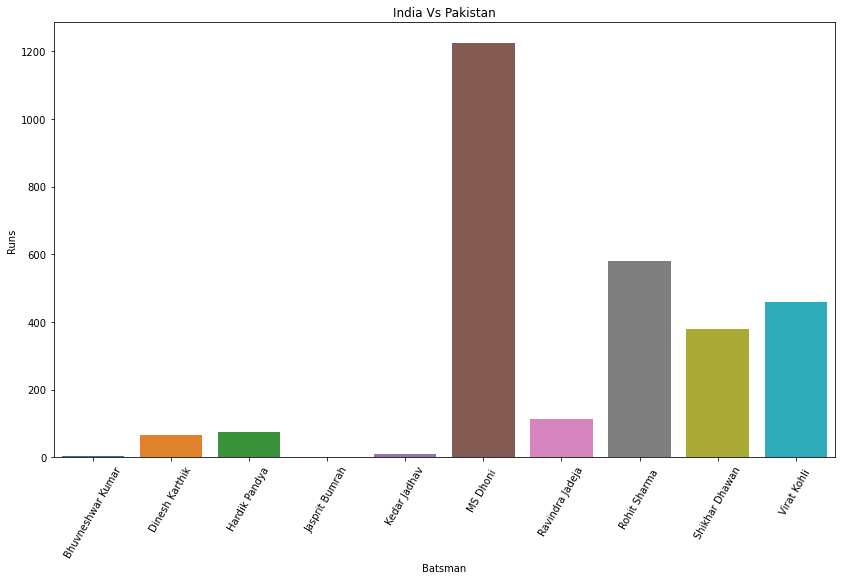

In [65]:
#Graphical representation of the top Indian batsmen against Pakistan
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = Pakistan)
plt.title("India Vs Pakistan")
plt.xticks(rotation = 60)

### **India Vs New Zealand**

In [66]:
NewZealand = India[India['Opposition'] == 'v New Zealand']
NewZealand.loc[NewZealand['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v New Zealand
Batsman,Virat Kohli
Runs,1302
BF,1348
SR,1758.69
4s,116
6s,18
Player_ID,5329842


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 <a list of 13 Text major ticklabel objects>)

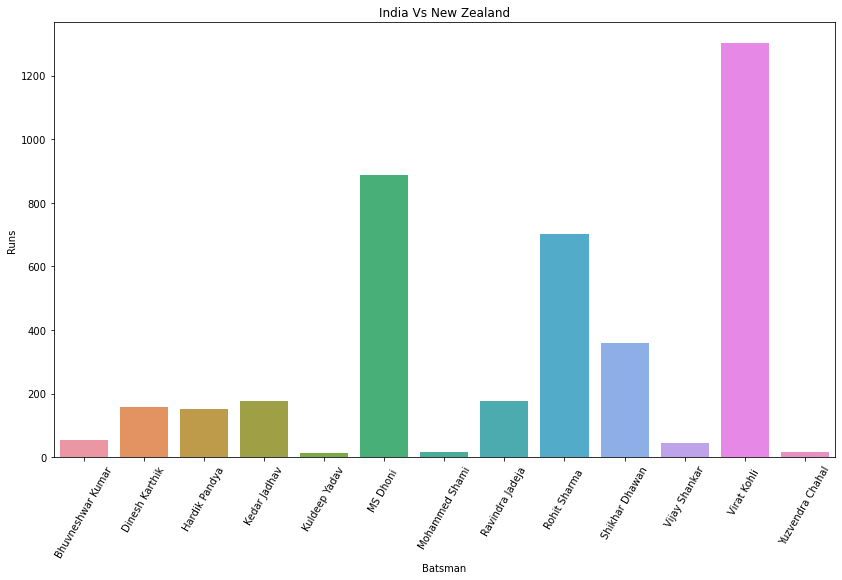

In [67]:
#Graphical representation of the top Indian batsmen against NewZealand
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = NewZealand)
plt.title("India Vs New Zealand")
plt.xticks(rotation = 60)

### **India Vs England**

In [68]:
England = India[India['Opposition'] == 'v England']
England.loc[England['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v England
Batsman,MS Dhoni
Runs,1470
BF,1701
SR,3324.48
4s,122
6s,31
Player_ID,1067078


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 <a list of 13 Text major ticklabel objects>)

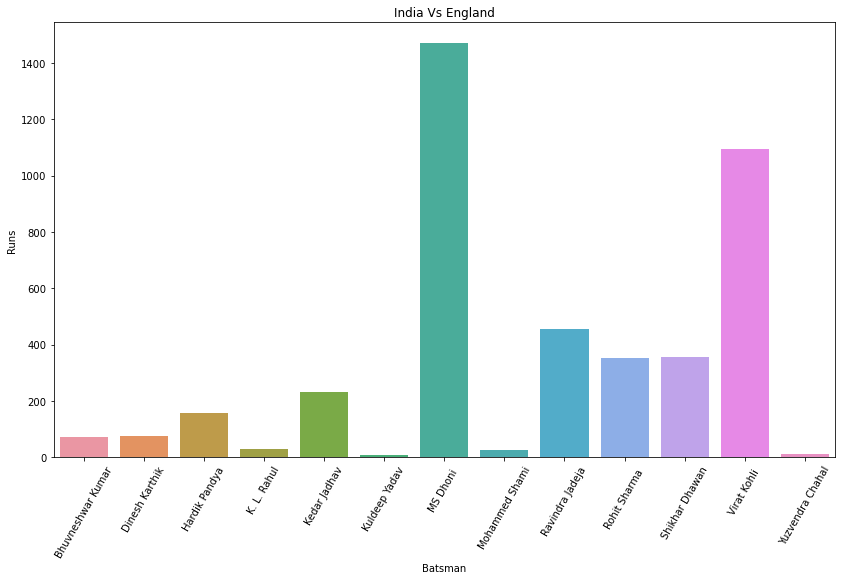

In [69]:
#Graphical representation of the top Indian batsmen against England
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = England)
plt.title("India Vs England")
plt.xticks(rotation = 60)

### **India Vs South Africa**

In [70]:
SouthAfrica = India[India['Opposition'] == 'v South Africa']
SouthAfrica.loc[SouthAfrica['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v South Africa
Batsman,Virat Kohli
Runs,1259
BF,1427
SR,1650.66
4s,102
6s,16
Player_ID,5076040


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

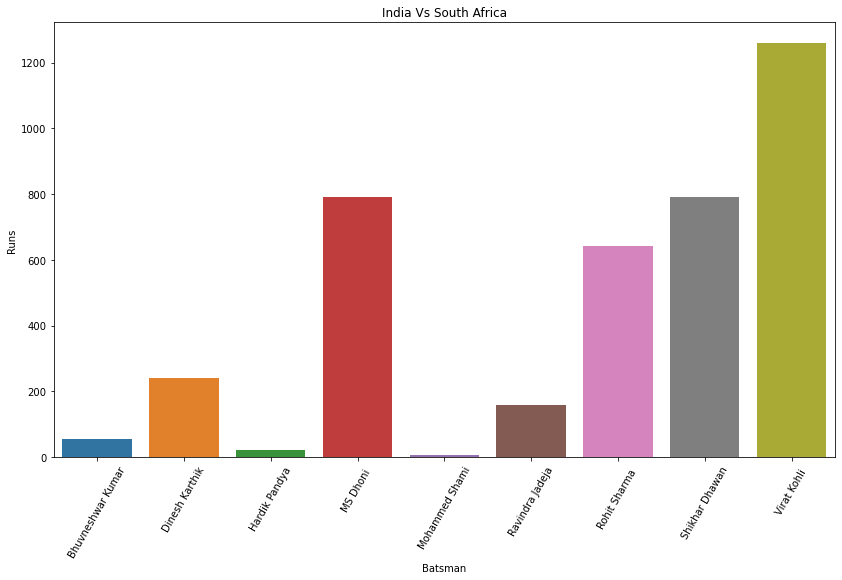

In [71]:
#Graphical representation of the top Indian batsmen against SouthAfrica
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = SouthAfrica)
plt.title("India Vs South Africa")
plt.xticks(rotation = 60)

### **India Vs Bangladesh**

In [72]:
Bangladesh = India[India['Opposition'] == 'v Bangladesh']
Bangladesh.loc[Bangladesh['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v Bangladesh
Batsman,Virat Kohli
Runs,653
BF,654
SR,876.17
4s,64
6s,5
Player_ID,2538020


(array([0, 1, 2, 3, 4, 5, 6, 7]), <a list of 8 Text major ticklabel objects>)

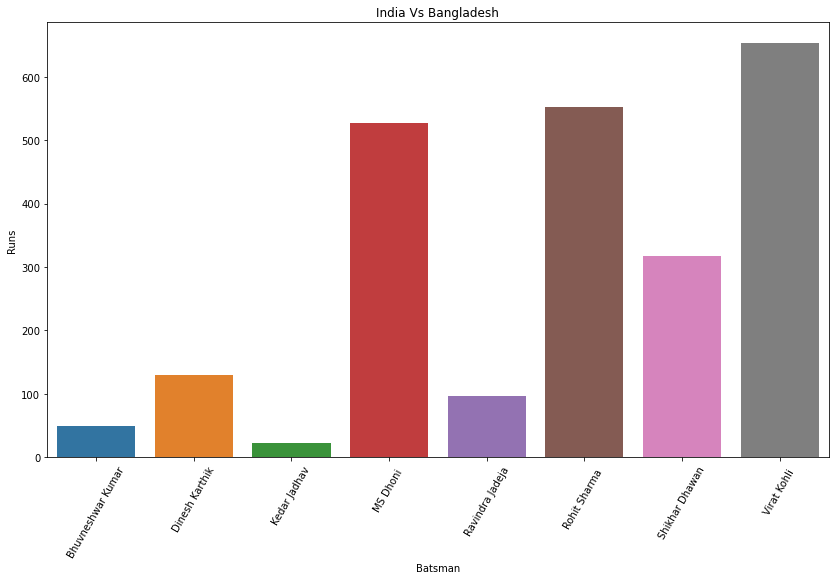

In [73]:
#Graphical representation of the top Indian batsmen against Bangladesh
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = Bangladesh)
plt.title("India Vs Bangladesh")
plt.xticks(rotation = 60)

### **India Vs Australia**

In [74]:
Australia = India[India['Opposition'] == 'v Australia']
Australia.loc[Australia['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v Australia
Batsman,Rohit Sharma
Runs,1975
BF,2069
SR,2636.76
4s,159
6s,69
Player_ID,1023060


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 <a list of 13 Text major ticklabel objects>)

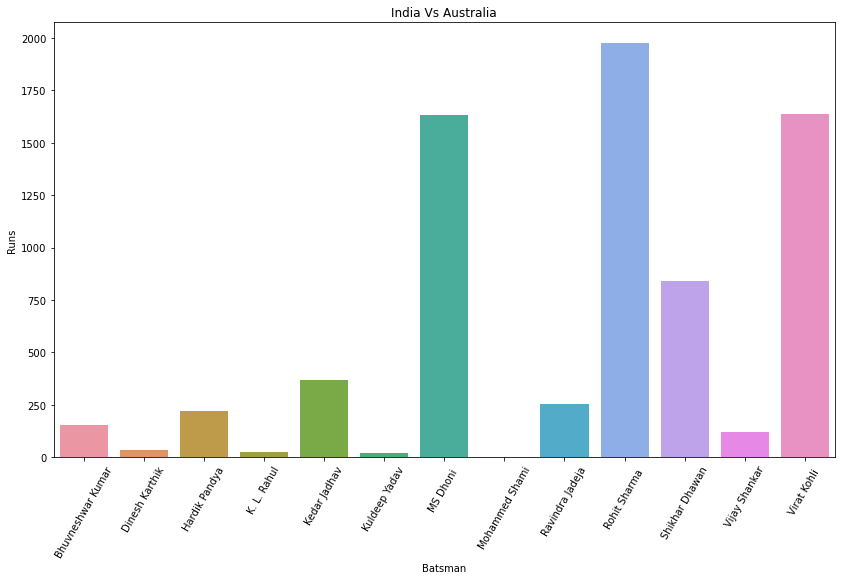

In [75]:
#Graphical representation of the top Indian batsmen against Australia
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = Australia)
plt.title("India Vs Australia")
plt.xticks(rotation = 60)

### **India Vs Sri Lanka**

In [76]:
SriLanka = India[India['Opposition'] == 'v Sri Lanka']
SriLanka.loc[SriLanka['Runs'].idxmax()].to_frame(name = 'Details')

,Details
Opposition,v Sri Lanka
Batsman,MS Dhoni
Runs,2371
BF,2632
SR,4142.93
4s,181
6s,44
Player_ID,1347888


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 <a list of 12 Text major ticklabel objects>)

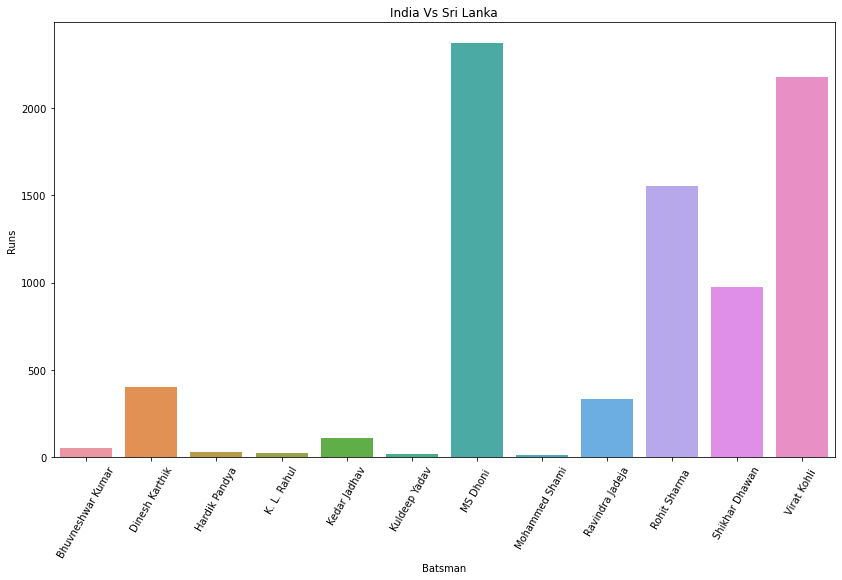

In [77]:
#Graphical representation of the top Indian batsmen against SriLanka
plt.figure(figsize=(14,8))
sns.barplot(x = "Batsman",y = 'Runs',data = SriLanka)
plt.title("India Vs Sri Lanka")
plt.xticks(rotation = 60)

# Cleaning Bowlers DataSet 

In [78]:
Bowler.head()

,Unnamed: 0,Overs,Mdns,Runs,Wkts,Econ,Ave,SR,Opposition,Ground,Start Date,Match_ID,Bowler,Player_ID
0,1,8.0,0,57,0,7.12,-,-,v India,Nagpur,18 Dec 2009,ODI # 2933,Suranga Lakmal,49619
1,2,10.0,0,55,2,5.50,27.50,30.0,v India,Kolkata,24 Dec 2009,ODI # 2935,Suranga Lakmal,49619
2,3,-,-,-,-,-,-,-,v India,Delhi,27 Dec 2009,ODI # 2936,Suranga Lakmal,49619
3,4,9.0,1,63,2,7.00,31.50,27.0,v Bangladesh,Dhaka,4 Jan 2010,ODI # 2937,Suranga Lakmal,49619
4,5,8.0,1,48,0,6.00,-,-,v India,Dhaka,5 Jan 2010,ODI # 2938,Suranga Lakmal,49619


In [79]:
Bowler.drop(columns = 'Unnamed: 0',axis = 1,inplace = True)
Bowler.replace('-',0,inplace = True)

Bowler = Bowler.astype({'SR':'float64','Ave':'float64','Runs':'int64','Wkts':'int64','Mdns':'int64',
                        'Econ':'float64'})
Bowler = Bowler.astype({'Overs':'str'})

In [80]:
def overs_to_ball(value):
    if "." in value:
        over = value.split(".")
        return int(over[0]) * 6 + int(over[1])
    else:
        return int(value) * 6
Bowler["Balls"] = Bowler['Overs'].apply(overs_to_ball)
Bowler.drop(columns = 'Overs',axis = 1,inplace = True)

In [81]:
Bowler.head()

,Mdns,Runs,Wkts,Econ,Ave,SR,Opposition,Ground,Start Date,Match_ID,Bowler,Player_ID,Balls
0,0,57,0,7.12,0.0,0.0,v India,Nagpur,18 Dec 2009,ODI # 2933,Suranga Lakmal,49619,48
1,0,55,2,5.50,27.5,30.0,v India,Kolkata,24 Dec 2009,ODI # 2935,Suranga Lakmal,49619,60
2,0,0,0,0.00,0.0,0.0,v India,Delhi,27 Dec 2009,ODI # 2936,Suranga Lakmal,49619,0
3,1,63,2,7.00,31.5,27.0,v Bangladesh,Dhaka,4 Jan 2010,ODI # 2937,Suranga Lakmal,49619,54
4,1,48,0,6.00,0.0,0.0,v India,Dhaka,5 Jan 2010,ODI # 2938,Suranga Lakmal,49619,48


    1. Econ : Economy of Bowler means, how many runs does the Bowler concede in one Over?
    2. Ave : Average for a Bowler means, how many runs conceded by Bowler per wicket.
    3. SR : Strike Rate refers to no.of balls bowled for gaining the wicket.
    4. Mdns : Maiden Over refers that the Bowler didn't concede any run.

In [82]:
ProfileReport(Bowler)

In [83]:
#Selecting Pitches that are there in England.
Stadiums = [item[0] for item in set(England_Pitches)]
Bowl = Bowler[Bowler['Ground'].isin(Stadiums)]

In [84]:
Bowl = Bowl.groupby(["Ground","Bowler"]).sum().reset_index()

Since our Bowl DataFrame doesnt have the details about the country name of each player, we add that using out Players DataFrame.

In [85]:
#To check whether each element in Bat['Player_ID'] is contained in Players['ID'].
Bowl = Bowl[Bowl['Player_ID'].isin(Players['Player_ID'])] 
Bowl.head()

,Ground,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
1,Birmingham,Adam Zampa,0,52,0,6.24,0.0,0.0,379504,50
13,Birmingham,David Willey,0,65,1,6.50,65.0,60.0,308251,60
17,Birmingham,Fakhar Zaman,0,0,0,0.00,0.0,0.0,512191,0
23,Birmingham,Imran Tahir,0,16,0,4.00,0.0,0.0,40618,24
25,Birmingham,James Neesham,0,0,0,0.00,0.0,0.0,355269,0


In [86]:
Bowler_ID = Bowl[["Player_ID","Bowler"]].drop_duplicates() #Return DataFrame with duplicate rows removed.

In [87]:
#To add a column called country.
Player_ID = list(Bowl.merge(Bowler_ID,how = "left",on = "Bowler")["Player_ID_y"].astype("int"))
Bowl["Player_ID"] = Player_ID

Players.columns = ["Player", "Player_ID","Country"]
Player_Country = list(Bowl.merge(Players,how = "left",on = "Player_ID")["Country"])
Bowl["Country"] = Player_Country

In [88]:
Bowlers_Overall = Bowl[(Bowl['Balls']> 36) & (Bowl['Wkts'] > 0)]
Bowlers_Overall.head()

,Ground,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
13,Birmingham,David Willey,0,65,1,6.50,65.00,60.0,308251,60,England
38,Birmingham,Lasith Malinga,0,50,3,5.45,16.66,18.3,49758,55,SriLanka
42,Birmingham,Mark Wood,1,33,4,3.30,8.25,15.0,351588,60,England
50,Birmingham,Mohammed Shami,1,28,3,3.73,9.33,15.0,481896,45,India
78,Bristol,Ashley Nurse,0,59,1,7.37,59.00,48.0,315594,48,WestIndies


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

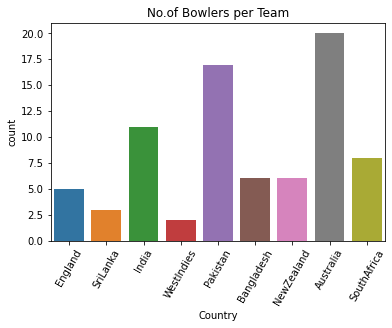

In [89]:
sns.countplot(Bowlers_Overall["Country"])
plt.title("No.of Bowlers per Team")
plt.xticks(rotation = 60)

In [90]:
Bowl.head()

,Ground,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
1,Birmingham,Adam Zampa,0,52,0,6.24,0.0,0.0,379504,50,Australia
13,Birmingham,David Willey,0,65,1,6.50,65.0,60.0,308251,60,England
17,Birmingham,Fakhar Zaman,0,0,0,0.00,0.0,0.0,512191,0,Pakistan
23,Birmingham,Imran Tahir,0,16,0,4.00,0.0,0.0,40618,24,SouthAfrica
25,Birmingham,James Neesham,0,0,0,0.00,0.0,0.0,355269,0,NewZealand


In [91]:
Bowl['Country'].unique()

array(['Australia', 'England', 'Pakistan', 'SouthAfrica', 'NewZealand',
       'SriLanka', 'India', 'Bangladesh', 'WestIndies'], dtype=object)

## 3. The top 3 Bowlers for each country (Based on Wickets).

In [92]:
GRUP = Bowl.groupby('Country')

**INDIA**

In [93]:
India_Bowl = GRUP.get_group('India')
India_Bowl.set_index('Bowler',inplace = True)

In [94]:
India_Bowl.drop(columns = 'Ground', axis = 1,inplace = True)
India_Bowl = India_Bowl.groupby("Bowler").sum() #Groups each Bowler and then takes their sum.

In [95]:
India_Bowl.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Kuldeep Yadav,0,148,9,14.80,26.82,30.0,1677705,180
Mohammed Shami,1,152,8,18.70,91.33,117.0,1927584,195
Ravindra Jadeja,0,164,2,17.79,98.00,114.0,704025,168


**Pakistan**

In [96]:
Pakistan = GRUP.get_group('Pakistan')
Pakistan.set_index('Bowler',inplace = True)

In [97]:
Pakistan.drop(columns = 'Ground', axis = 1,inplace = True)
Pakistan = Pakistan.groupby("Bowler").sum() 

In [98]:
Pakistan.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Imad Wasim,0,208,6,24.90,158.0,153.0,911032,204
Faheem Ashraf,0,181,3,21.07,93.5,73.0,2724468,152
Hasan Ali,1,241,3,26.04,186.0,174.0,2725220,222


**NewZealand**

In [99]:
NewZealand = GRUP.get_group('NewZealand')
NewZealand.set_index('Bowler',inplace = True)

In [100]:
NewZealand.drop(columns = 'Ground', axis = 1,inplace = True)
NewZealand = NewZealand.groupby("Bowler").sum() 

In [101]:
NewZealand.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Tim Southee,3,82,7,9.08,24.16,31.6,464728,110
Mitchell Santner,0,166,6,29.58,76.83,63.0,2010856,132
Matt Henry,0,251,5,28.80,107.50,90.0,2026448,210


**SouthAfrica**

In [102]:
SouthAfrica = GRUP.get_group('SouthAfrica')
SouthAfrica.set_index('Bowler',inplace = True)

In [103]:
SouthAfrica.drop(columns = 'Ground', axis = 1,inplace = True)
SouthAfrica = SouthAfrica.groupby("Bowler").sum() 

In [104]:
SouthAfrica.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Kagiso Rabada,2,188,7,21.47,97.75,97.5,2200860,210
Andile Phehlukwayo,1,158,3,18.95,103.50,87.0,1620948,144
Chris Morris,1,186,3,27.45,60.50,54.0,1759808,168


**SriLanka**

In [105]:
SriLanka = GRUP.get_group('SriLanka')
SriLanka.set_index('Bowler',inplace = True)

In [106]:
SriLanka.drop(columns = 'Ground', axis = 1,inplace = True)
SriLanka = SriLanka.groupby("Bowler").sum() 

In [107]:
SriLanka.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Jeevan Mendis,0,170,6,42.99,81.50,78.0,298200,174
Lasith Malinga,0,78,3,11.05,16.66,18.3,99516,85
Nuwan Pradeep,0,95,2,14.15,32.00,30.0,973074,84


**Bangladesh**

In [108]:
Bangladesh = GRUP.get_group('Bangladesh')
Bangladesh.set_index('Bowler',inplace = True)

In [109]:
Bangladesh.drop(columns = 'Ground', axis = 1,inplace = True)
Bangladesh = Bangladesh.groupby("Bowler").sum() 

In [110]:
Bangladesh.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Shakib Al Hasan,0,127,4,12.70,37.50,60.0,168429,180
Mosaddek Hossain,0,73,3,17.23,4.33,6.0,1650399,74
Rubel Hossain,0,112,3,11.77,86.00,87.0,601238,114


**Australia**

In [111]:
Australia = GRUP.get_group('Australia')
Australia.set_index('Bowler',inplace = True)

In [112]:
Australia.drop(columns = 'Ground', axis = 1,inplace = True)
Australia = Australia.groupby("Bowler").sum() 

In [113]:
Australia.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Mitchell Starc,2,119,7,13.91,69.75,84.7,934776,153
Pat Cummins,2,119,7,12.70,58.25,91.5,1469667,165
Kane Richardson,1,156,6,18.10,94.00,96.0,816786,156


**WestIndies**

In [114]:
WestIndies = GRUP.get_group('WestIndies')
WestIndies.set_index('Bowler',inplace = True)

In [115]:
WestIndies.drop(columns = 'Ground', axis = 1,inplace = True)
WestIndies = WestIndies.groupby("Bowler").sum() 

In [116]:
WestIndies.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Jason Holder,0,162,2,28.12,40.5,30.0,1565940,140
Ashley Nurse,0,202,1,32.80,59.0,48.0,1577970,167
Andre Russell,0,43,0,7.16,0.0,0.0,276298,36


**England**

In [117]:
England = GRUP.get_group('England')
England.set_index('Bowler',inplace = True)

In [118]:
England.drop(columns = 'Ground', axis = 1,inplace = True)
England = England.groupby("Bowler").sum()

In [119]:
England.nlargest(3,'Wkts')

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Tom Curran,1,211,7,21.1,117.75,105.0,1650705,180
Mark Wood,2,82,6,12.3,57.25,81.0,1054764,126
David Willey,0,65,1,6.5,65.00,60.0,308251,60


## 4. Which Countries have Best Bowlers? (Based on different criterias)

In [120]:
Best_Bowler_TeamWise = Bowl.groupby('Country').agg({'Runs':'sum','Mdns':'sum','Wkts':'sum','Balls':'sum','Econ': 'mean',
                                                    'Ave':'mean','SR':'mean'}).reset_index()
Best_Bowler_TeamWise

,Country,Runs,Mdns,Wkts,Balls,Econ,Ave,SR
0,Australia,1309,9,40,1415,3.795745,13.960851,16.334043
1,Bangladesh,591,0,13,663,3.296154,7.724231,9.115385
2,England,456,3,14,446,4.547143,17.142857,17.571429
3,India,822,1,23,924,2.986061,12.883333,14.818182
4,NewZealand,612,4,21,560,5.054500,13.649500,12.530000
5,Pakistan,1278,3,24,1178,3.843171,19.979512,18.365854
6,SouthAfrica,768,4,17,750,3.761111,15.324074,14.388889
7,SriLanka,376,0,12,385,3.315000,5.352308,5.319231
8,WestIndies,407,0,3,343,2.960000,4.326087,3.391304


***Based on Wickets***

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

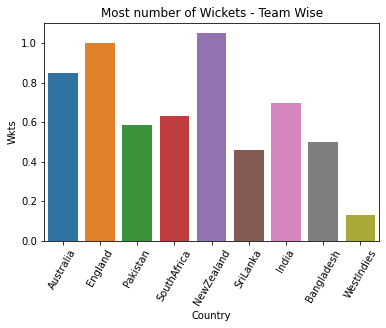

In [121]:
#plt.figure(figsize=(14,8))
sns.barplot(x = "Country", y = "Wkts", data = Bowl, ci = None)
plt.title("Most number of Wickets - Team Wise")
plt.xticks(rotation = 60)

***New Zealand has a higher rate of taking wickets***

***Based on Economy***

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

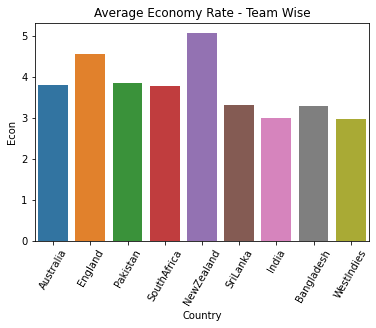

In [122]:
#plt.figure(figsize=(14,8))
sns.barplot(x = "Country", y = "Econ", data = Bowl, ci = None)
plt.title("Average Economy Rate - Team Wise")
plt.xticks(rotation = 60)

****Batsmen can target High Economy Rate Teams like England, New Zealand and India****

***Based on Average***

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

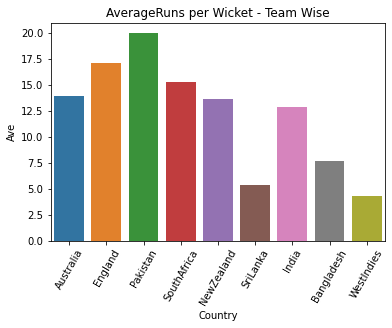

In [123]:
#plt.figure(figsize=(14,8))
sns.barplot(x = "Country", y = "Ave", data = Bowl, ci = None)
plt.title("AverageRuns per Wicket - Team Wise")
plt.xticks(rotation = 60)

***On an Average, West Indies has less Average Rate.***

***Based on Strike Rate***

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

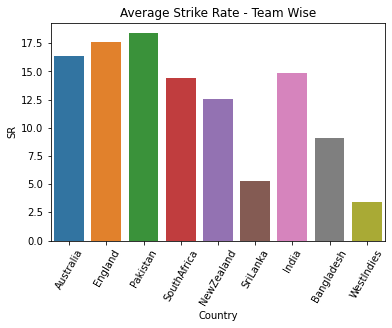

In [124]:
#plt.figure(figsize=(14,8))
sns.barplot(x = "Country", y = "SR", data = Bowl, ci = None)
plt.title("Average Strike Rate - Team Wise")
plt.xticks(rotation = 60)

***The lower the strike rate, the more effective a bowler is at taking wickets quickly.***

***West Indies has good consistency Strike Rate.***

### Overall Team with Best Bowlers 

***Best Bowlers : Qualifying Criteria are:-***

    1. Average Less than 40
    2. Strike Rate Less than 40
    3. Economy Rate Less than 7.5

In [125]:
Bowl.head()

,Ground,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
1,Birmingham,Adam Zampa,0,52,0,6.24,0.0,0.0,379504,50,Australia
13,Birmingham,David Willey,0,65,1,6.50,65.0,60.0,308251,60,England
17,Birmingham,Fakhar Zaman,0,0,0,0.00,0.0,0.0,512191,0,Pakistan
23,Birmingham,Imran Tahir,0,16,0,4.00,0.0,0.0,40618,24,SouthAfrica
25,Birmingham,James Neesham,0,0,0,0.00,0.0,0.0,355269,0,NewZealand


In [126]:
pd.set_option('display.max_rows', 193)       #To display all 193 rows

#Selecting Bowlers satisfying the criteria.
Best_Bowler_Overall = Bowl[(Bowl['Ave'] < 40) & (Bowl['SR'] < 40) & (Bowl['Econ'] < 7.5)] 
Best_Bowler_Overall

,Ground,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
1,Birmingham,Adam Zampa,0,52,0,6.24,0.00,0.0,379504,50,Australia
17,Birmingham,Fakhar Zaman,0,0,0,0.00,0.00,0.0,512191,0,Pakistan
23,Birmingham,Imran Tahir,0,16,0,4.00,0.00,0.0,40618,24,SouthAfrica
25,Birmingham,James Neesham,0,0,0,0.00,0.00,0.0,355269,0,NewZealand
29,Birmingham,Jonny Bairstow,0,0,0,0.00,0.00,0.0,297433,0,England
32,Birmingham,Kagiso Rabada,1,36,0,5.14,0.00,0.0,550215,42,SouthAfrica
35,Birmingham,Kusal Mendis,0,0,0,0.00,0.00,0.0,629074,0,SriLanka
37,Birmingham,Lahiru Thirimanne,0,0,0,0.00,0.00,0.0,301236,0,SriLanka
38,Birmingham,Lasith Malinga,0,50,3,5.45,16.66,18.3,49758,55,SriLanka
42,Birmingham,Mark Wood,1,33,4,3.30,8.25,15.0,351588,60,England


(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

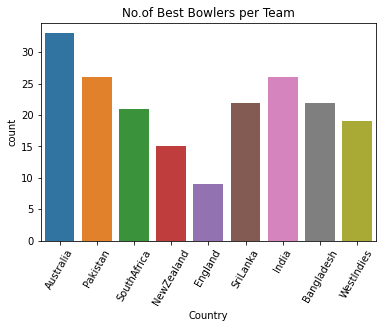

In [127]:
sns.countplot(Best_Bowler_Overall['Country'])
plt.title("No.of Best Bowlers per Team")
plt.xticks(rotation = 60)

## 5. Does England have a ground advantage?

In [128]:
Ground.head()

,Ground,Span,Mat,Won,Tied,NR,Runs,Wkts,Balls,Ave,RPO
0,"Eden Gardens, Kolkata - India",2013-2017,4,4,0,0,2161,72,2297,30.01,5.64
1,"Feroz Shah Kotla, Delhi - India",2013-2019,4,4,0,0,1789,75,2331,23.85,4.60
2,Melbourne Cricket Ground - Australia,2013-2019,15,15,0,0,7656,217,8482,35.28,5.41
3,"Saurashtra Cricket Association Stadium, Rajkot...",2013-2015,2,2,0,0,1163,26,1200,44.73,5.81
4,Adelaide Oval - Australia,2013-2019,10,10,0,0,4863,157,5645,30.97,5.16


In [129]:
Match_Total.head()

,Unnamed: 0,Score,Overs,RPO,Target,Inns,Result,Opposition,Ground,Start Date,Match_ID,Country,Country_ID
0,412,250,48.3,5.15,NaN,1,won,v India,Kolkata,3 Jan 2013,ODI # 3315,Pakistan,7
1,680,165,48.0,3.43,251.0,2,lost,v Pakistan,Kolkata,3 Jan 2013,ODI # 3315,India,6
2,413,157,48.5,3.21,168.0,2,lost,v India,Delhi,6 Jan 2013,ODI # 3316,Pakistan,7
3,681,167,43.4,3.82,NaN,1,won,v Pakistan,Delhi,6 Jan 2013,ODI # 3316,India,6
4,117,198,40.0,4.95,306.0,2,lost,v Australia,Melbourne,11 Jan 2013,ODI # 3317,SriLanka,8


In [130]:
Match_Total = Match_Total.astype({'Score':'str'})

In [131]:
Match_Total.rename(columns={'Unnamed: 0':'Scores_ID'},inplace = True)
Match_Total.replace('DNB',str(0),inplace = True)
Match_Total.dropna(axis = 1,how='any')


#Since the Scores contain values with '/' we try to remove the '/' and the values after that using a function. 
def overs_to_ball(value):
    if "/" in value:
        scr = value.split("/")
        return int(scr[0])
    else:
        return int(value)
Match_Total["Score"]= Match_Total['Score'].apply(overs_to_ball)


Match_Total.head()

,Scores_ID,Score,Overs,RPO,Target,Inns,Result,Opposition,Ground,Start Date,Match_ID,Country,Country_ID
0,412,250,48.3,5.15,NaN,1,won,v India,Kolkata,3 Jan 2013,ODI # 3315,Pakistan,7
1,680,165,48.0,3.43,251.0,2,lost,v Pakistan,Kolkata,3 Jan 2013,ODI # 3315,India,6
2,413,157,48.5,3.21,168.0,2,lost,v India,Delhi,6 Jan 2013,ODI # 3316,Pakistan,7
3,681,167,43.4,3.82,NaN,1,won,v Pakistan,Delhi,6 Jan 2013,ODI # 3316,India,6
4,117,198,40.0,4.95,306.0,2,lost,v Australia,Melbourne,11 Jan 2013,ODI # 3317,SriLanka,8


In [132]:
# Replace ground name with full ground names in ODI_Total dataframe.

Ground_Info = Match_Total[Match_Total['Ground'].isin([Ground[0] for Ground in England_Pitches])] 
Ground_Info['Ground'] = Ground_Info['Ground'].apply(Pitch_Name)  #Here we apply the names of the Ground_Name dictionary.
Ground_Info.head()

,Scores_ID,Score,Overs,RPO,Target,Inns,Result,Opposition,Ground,Start Date,Match_ID,Country,Country_ID
74,557,231,46.5,4.93,228.0,2,won,v England,"Lord's, London",31 May 2013,ODI # 3360,Newzealad,5
75,844,227,50.0,4.54,NaN,1,lost,v New Zealand,"Lord's, London",31 May 2013,ODI # 3360,England,1
76,558,359,50.0,7.18,NaN,1,won,v England,"Rose Bowl, Southampton",2 Jun 2013,ODI # 3361,Newzealad,5
77,845,273,44.1,6.18,360.0,2,lost,v New Zealand,"Rose Bowl, Southampton",2 Jun 2013,ODI # 3361,England,1
78,559,253,46.3,5.44,288.0,2,lost,v England,"Trent Bridge, Nottingham",5 Jun 2013,ODI # 3362,Newzealad,5


,Country,Total
0,Australia,20
1,Bangladesh,4
2,England,68
3,India,17
4,Newzealad,14
5,Pakistan,18
6,SouthAfrica,10
7,SriLanka,17
8,WestIndies,8


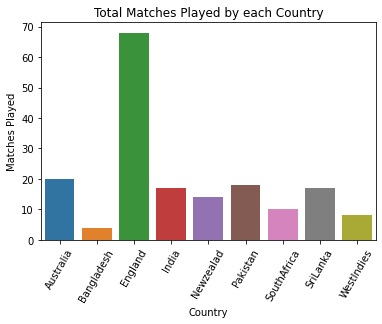

In [133]:
#To see the total number of matches played in the England Pitches by each country previously.
Team_Matches = Ground_Info['Country'].reset_index()
Team_Matches = Team_Matches.groupby('Country')['Country'].count()
Team_Matches= Team_Matches.to_frame(name = 'Total')
Team_Matches.reset_index(inplace = True)


#Here we plot the information from the above.
sns.barplot(x = "Country", y = "Total", data = Team_Matches, ci = None)
plt.title("Total Matches Played by each Country")
plt.xlabel("Country")
plt.ylabel("Matches Played")
plt.xticks(rotation = 60)

Team_Matches

#### Thus we can see that England has more experience with the ground than any other country. But lets not get fooled by this. 

**We will try to find the win percentage of each country and then plot these values to check by whether or not England has an advantage as compared to other countries.**

In [134]:
#Find matches that are won by each country on England Grounds.
def findMatchesWon(country):
    country_played = Ground_Info['Country'] == country
    won = Ground_Info['Result']=='won'
    country_stats = Ground_Info[country_played & won].groupby('Country')['Country'].count()
    return country_stats

#Find matches that are played by each country on England Grounds.
def findMatchesPlayed(country):
    return Ground_Info[Ground_Info['Country'] == country].groupby('Country')['Country'].count()

- **New Zealand**

In [135]:
Matches_Won_NZ = findMatchesWon('Newzealad')
Matches_Played_NZ =  findMatchesPlayed('Newzealad')
Win_per_NZ = round((Matches_Won_NZ.values.sum()/Matches_Played_NZ.values.sum())*100,2)
Win_per_NZ

35.71

- **England**

In [136]:
Matches_Won_ENG = findMatchesWon('England')
Matches_Played_ENG =  findMatchesPlayed('England')
Win_per_ENG = round((Matches_Won_ENG.values.sum()/Matches_Played_ENG.values.sum())*100,2)
Win_per_ENG

60.29

- **India**

In [137]:
Matches_Won_IND = findMatchesWon('India')
Matches_Played_IND =  findMatchesPlayed('India')
Win_per_IND = round((Matches_Won_IND.values.sum()/Matches_Played_IND.values.sum())*100,2)
Win_per_IND

70.59

- **Australia**

In [138]:
Matches_Won_AUS = findMatchesWon('Australia')
Matches_Played_AUS =  findMatchesPlayed('Australia')
Win_per_AUS = round((Matches_Won_AUS.values.sum()/Matches_Played_AUS.values.sum())*100,2)
Win_per_AUS

25.0

- **West Indies**

In [139]:
Matches_Won_WI = findMatchesWon('WestIndies')
Matches_Played_WI =  findMatchesPlayed('WestIndies')
Win_per_WI = round((Matches_Won_WI.values.sum()/Matches_Played_WI.values.sum())*100,2)
Win_per_WI

12.5

- **South Africa**

In [140]:
Matches_Won_SA = findMatchesWon('SouthAfrica')
Matches_Played_SA =  findMatchesPlayed('SouthAfrica')
Win_per_SA = round((Matches_Won_SA.values.sum()/Matches_Played_SA.values.sum())*100,2)
Win_per_SA

30.0

- **Sri Lanka**

In [141]:
Matches_Won_SL = findMatchesWon('SriLanka')
Matches_Played_SL =  findMatchesPlayed('SriLanka')
Win_per_SL = round((Matches_Won_SL.values.sum()/Matches_Played_SL.values.sum())*100,2)
Win_per_SL

35.29

- **Pakistan**

In [142]:
Matches_Won_PAK = findMatchesWon('Pakistan')
Matches_Played_PAK =  findMatchesPlayed('Pakistan')
Win_per_PAK = round((Matches_Won_PAK.values.sum()/Matches_Played_PAK.values.sum())*100,2)
Win_per_PAK

27.78

- **Bangladesh**

In [143]:
Matches_Won_BAN = findMatchesWon('Bangladesh')
Matches_Played_BAN =  findMatchesPlayed('Bangladesh')
Win_per_BAN = round((Matches_Won_BAN.values.sum()/Matches_Played_BAN.values.sum())*100,2)
Win_per_BAN

25.0

In [144]:
## ***Plotting using Plotly***

Teams = ['New Zealand', 'England', 'Australia', 'India', 'West Indies', 'South Africa', 'Sri Lanka', 
         'Pakistan', 'Bangladesh']
Values = [Win_per_NZ, Win_per_ENG, Win_per_AUS, Win_per_IND, Win_per_WI, Win_per_SA, Win_per_SL, Win_per_PAK, Win_per_BAN]

data = [go.Bar(x=Teams,y=Values,text=Values,textposition = 'inside',
               marker=dict(color='firebrick',line=dict(color='rgb(8,48,107)',width=1.5),),opacity=0.7)]
layout = go.Layout(title='Win Percentage of Teams on England Grounds',
                   xaxis_title="Country",
                   yaxis_title="Win Percentage")

fig = go.Figure(data=data, layout=layout)
fig.show()

##### This seems to be a great news for us, as India has approx 71% chance of winning. Thus we can conclude that despite England having the ground advantage, it's win percentage is a bit low as compared to that of India. 

## 6. Win-Loss Analysis of each country

In [145]:
Match_Result.head()

,Unnamed: 0,Result,Margin,BR,Toss,Bat,Opposition,Ground,Start Date,Match_ID,Country,Country_ID
0,418,won,85 runs,NaN,lost,1st,v India,Kolkata,3 Jan 2013,ODI # 3315,Pakistan,7
1,692,lost,85 runs,NaN,won,2nd,v Pakistan,Kolkata,3 Jan 2013,ODI # 3315,India,6
2,419,lost,10 runs,NaN,lost,2nd,v India,Delhi,6 Jan 2013,ODI # 3316,Pakistan,7
3,693,won,10 runs,NaN,won,1st,v Pakistan,Delhi,6 Jan 2013,ODI # 3316,India,6
4,121,lost,107 runs,NaN,lost,2nd,v Australia,Melbourne,11 Jan 2013,ODI # 3317,SriLanka,8


In [146]:
Ground_2019 = Match_Result[Match_Result['Ground'].isin([Ground[0] for Ground in England_Pitches])] 
Ground_2019['Ground'] = Ground_2019['Ground'].apply(Pitch_Name)  #Here we apply the names of the Ground_Name dictionary.
Ground_2019.head()

,Unnamed: 0,Result,Margin,BR,Toss,Bat,Opposition,Ground,Start Date,Match_ID,Country,Country_ID
75,566,won,5 wickets,19.0,won,2nd,v England,"Lord's, London",31 May 2013,ODI # 3360,Newzealad,5
76,860,lost,5 wickets,19.0,lost,1st,v New Zealand,"Lord's, London",31 May 2013,ODI # 3360,England,1
77,567,won,86 runs,NaN,won,1st,v England,"Rose Bowl, Southampton",2 Jun 2013,ODI # 3361,Newzealad,5
78,861,lost,86 runs,NaN,lost,2nd,v New Zealand,"Rose Bowl, Southampton",2 Jun 2013,ODI # 3361,England,1
79,568,lost,34 runs,NaN,won,2nd,v England,"Trent Bridge, Nottingham",5 Jun 2013,ODI # 3362,Newzealad,5


In [147]:
Match_Result['Result'].value_counts()

won     663
lost    562
n/r      54
aban     22
tied     14
canc      4
-         3
Name: Result, dtype: int64

In [148]:
Match_Result.dropna(axis = 1,how ='any',inplace = True)
Match_Result.drop(columns = 'Unnamed: 0',axis = 1,inplace = True)
Match_Result = Match_Result[Match_Result['Result'] != 'n/r']
Match_Result = Match_Result[Match_Result['Result'] != 'aban']
Match_Result = Match_Result[Match_Result['Result'] != 'tied']
Match_Result = Match_Result[Match_Result['Result'] != 'canc']
Match_Result = Match_Result[Match_Result['Result'] != '-']
Match_Result['Result'].value_counts()

won     663
lost    562
Name: Result, dtype: int64

In [149]:
Wins = Match_Result[['Country','Result']]
Wins['Count'] = 1
Results_Per_Team = Wins.groupby(["Country","Result"]).aggregate(["sum"])
Results_Per_Team = Results_Per_Team.groupby(level=0).apply(lambda x:100 * x / float(x.sum())).reset_index()
Results_Per_Team.columns = ["Country","Result","Count"]
Results_Per_Team.head()

,Country,Result,Count
0,Afghanistan,lost,45.882353
1,Afghanistan,won,54.117647
2,Australia,lost,40.650407
3,Australia,won,59.349593
4,Bangladesh,lost,47.777778


(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

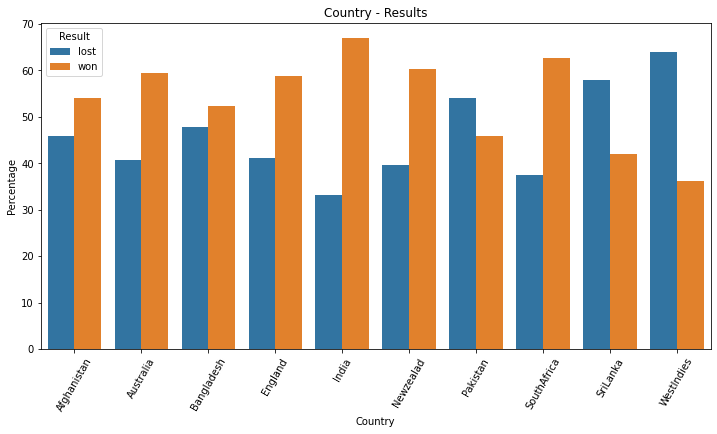

In [150]:
#Results chart.

plt.figure(figsize=(12,6))
sns.barplot(x = "Country", y = "Count", hue = "Result", data = Results_Per_Team)
plt.ylabel("Percentage")
plt.title("Country - Results")
plt.xticks(rotation = 60)

**From this we can say that India has the maximum wins and the minimum losses in England Grounds as compared to other teams.**

## 7. Win pattern in different grounds.

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

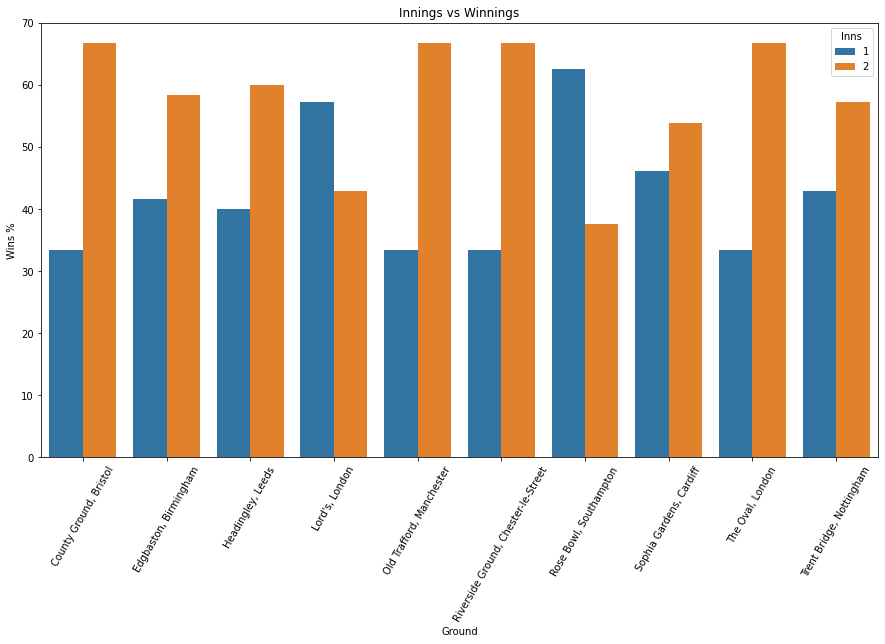

In [151]:
Pitch_Innings = Ground_Info[Ground_Info['Result'] == "won"][["Inns","Ground"]] 
Pitch_Innings["Wins %"] = 1 #We give this new column with value 1 so that we can take the sum when we group.
Pitch_Innings = Pitch_Innings.groupby(["Ground","Inns"]).sum()

#We first find the win% for each ground in each innings.
Pitch_Innings = Pitch_Innings.groupby(level=0).apply(lambda x:100 * x / float(x.sum())).reset_index()

plt.figure(figsize=(15,8))
sns.barplot(x = "Ground", y = "Wins %", hue = "Inns", data = Pitch_Innings)
plt.title("Innings vs Winnings")
plt.xticks(rotation = 60)

**Thus from the above plot we can conclude that most of the times the team that bowls first wins the match.**

<h1 align="center"> INDIAN CRICKET TEAM-2019 </h1> 

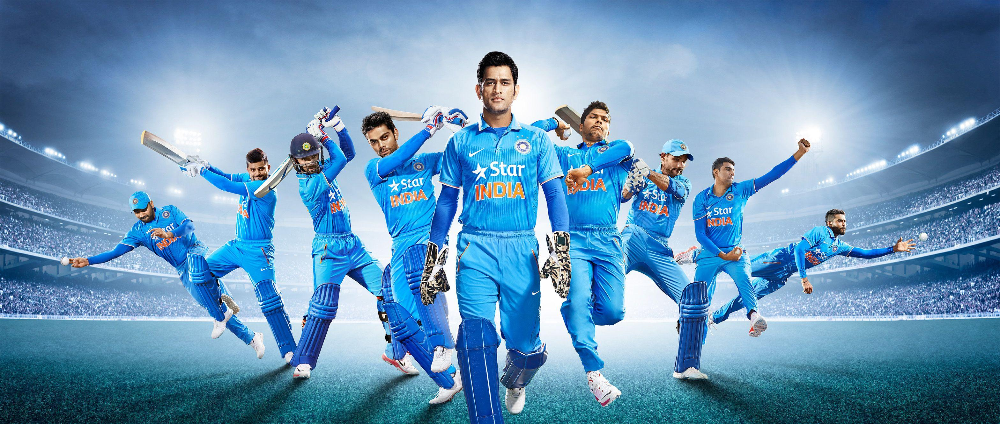

- **Top 6 Indian Batsmen with higher Runs and Strike Rate**

In [152]:
India_Runs = India_Bat[India_Bat['Runs'] > 50]
India_Bat_Runs = India_Runs.nlargest(10,'Runs')
India_Bat_Runs.reset_index(inplace = True)
India_Bat_Runs

,Batsman,Runs,BF,SR,4s,6s,Player_ID
0,Rohit Sharma,154,158,188.97,17,4,102306
1,Dinesh Karthik,135,170,407.50,17,1,180270
2,Ravindra Jadeja,132,102,393.27,12,4,704025
3,Hardik Pandya,118,86,372.19,7,6,1876113
4,MS Dhoni,99,152,377.20,7,0,140405
5,Virat Kohli,64,82,175.34,4,0,507604


In [153]:
India_BSR = India_Bat[India_Bat['SR'] > 100]
India_Bat_SR = India_BSR.nlargest(10,'SR')
India_Bat_SR.reset_index(inplace = True)
India_Bat_SR

,Batsman,Runs,BF,SR,4s,6s,Player_ID
0,Dinesh Karthik,135,170,407.50,17,1,180270
1,Ravindra Jadeja,132,102,393.27,12,4,704025
2,MS Dhoni,99,152,377.20,7,0,140405
3,Hardik Pandya,118,86,372.19,7,6,1876113
4,Rohit Sharma,154,158,188.97,17,4,102306
5,Virat Kohli,64,82,175.34,4,0,507604
6,Shikhar Dhawan,36,30,120.00,6,0,28235


In [154]:
## **Indian Batting Team**
India_Players_Bat = India_Bat_Runs.merge(India_Bat_SR,how ='inner',on = "Batsman")['Batsman']
India_Players_Bat = India_Players_Bat.to_frame(name = 'Indian Team')
India_Players_Bat

,Indian Team
0,Rohit Sharma
1,Dinesh Karthik
2,Ravindra Jadeja
3,Hardik Pandya
4,MS Dhoni
5,Virat Kohli


- **Top 6 Indian Bowlers with higher Wickets and lower Strike Rate**

In [155]:
India_Wkts = India_Bowl[India_Bowl['Wkts'] > 0]
India_Bowl_Wkts = India_Wkts.nlargest(10,'Wkts')
India_Bowl_Wkts.reset_index(inplace = True)
India_Bowl_Wkts

,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
0,Kuldeep Yadav,0,148,9,14.80,26.82,30.0,1677705,180
1,Mohammed Shami,1,152,8,18.70,91.33,117.0,1927584,195
2,Ravindra Jadeja,0,164,2,17.79,98.00,114.0,704025,168
3,Yuzvendra Chahal,0,135,2,13.50,94.00,120.0,1290738,180
4,Bhuvneshwar Kumar,0,45,1,5.62,45.00,48.0,326016,48
5,Hardik Pandya,0,156,1,20.80,70.00,60.0,1876113,135


In [156]:
India_SR = India_Bowl[India_Bowl['SR'] > 0]
India_Bowl_SR = India_SR.nsmallest(10,'SR')
India_Bowl_SR.reset_index(inplace = True)
India_Bowl_SR

,Bowler,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
0,Kuldeep Yadav,0,148,9,14.80,26.82,30.0,1677705,180
1,Bhuvneshwar Kumar,0,45,1,5.62,45.00,48.0,326016,48
2,Hardik Pandya,0,156,1,20.80,70.00,60.0,1876113,135
3,Ravindra Jadeja,0,164,2,17.79,98.00,114.0,704025,168
4,Mohammed Shami,1,152,8,18.70,91.33,117.0,1927584,195
5,Yuzvendra Chahal,0,135,2,13.50,94.00,120.0,1290738,180


In [157]:
## **Indian Bowling Team**
India_Players_Bowl = India_Bowl_Wkts.merge(India_Bowl_SR,how ='outer',on = "Bowler")['Bowler']
India_Players_Bowl = India_Players_Bowl.to_frame(name = 'Indian Team')
India_Players_Bowl

,Indian Team
0,Kuldeep Yadav
1,Mohammed Shami
2,Ravindra Jadeja
3,Yuzvendra Chahal
4,Bhuvneshwar Kumar
5,Hardik Pandya


## 8. Team INDIA


- **These are the 10 players that have a crucial role in the 2019 World Cup. They are infact in the safe zone.**

In [158]:
Indian_Players = India_Players_Bat.merge(India_Players_Bowl,how ='outer',on = "Indian Team")['Indian Team']
Indian_Players = Indian_Players.to_frame(name = 'Indian Team')
Indian_Players

,Indian Team
0,Rohit Sharma
1,Dinesh Karthik
2,Ravindra Jadeja
3,Hardik Pandya
4,MS Dhoni
5,Virat Kohli
6,Kuldeep Yadav
7,Mohammed Shami
8,Yuzvendra Chahal
9,Bhuvneshwar Kumar


## 9. Threatening Players in each team. (Against INDIA)

### ***Batsmen***

> **Here we consider two main criterias for a Batsman to be considered Dangerous:-**

1. The Runs scored
2. Strike Rate (Should be high)

In [159]:
Danger_Bat = Batsman.copy()

In [160]:
Danger_Bat.head()

,Runs,BF,SR,4s,6s,Opposition,Ground,Start Date,Match_ID,Batsman,Player_ID
18,2,11,18.18,0,0,v Pakistan,Abu Dhabi,25 Dec 2013,ODI # 3448,Oshane Thomas,49619
31,7,17,41.17,0,0,v New Zealand,Christchurch,14 Feb 2015,ODI # 3599,Oshane Thomas,49619
41,8,9,88.88,0,0,v New Zealand,Christchurch,26 Dec 2015,ODI # 3714,Oshane Thomas,49619
43,7,8,87.50,0,0,v England,Nottingham,21 Jun 2016,ODI # 3751,Oshane Thomas,49619
47,10,23,43.47,1,0,v England,Cardiff,2 Jul 2016,ODI # 3758,Oshane Thomas,49619


In [161]:
Danger_Bat = Danger_Bat.groupby(["Ground","Batsman","Opposition"]).sum().reset_index()
Danger_Bat = Danger_Bat[Danger_Bat['Player_ID'].isin(Players['Player_ID'])] 
Danger_Bat.head()

,Ground,Batsman,Opposition,Runs,BF,SR,4s,6s,Player_ID
1,Abu Dhabi,Adil Rashid,v Pakistan,7,13,53.84,0,0,244497
2,Abu Dhabi,Alex Carey,v Pakistan,25,21,119.04,0,1,326434
6,Abu Dhabi,Asghar Afghan,v Pakistan,67,56,119.64,2,5,320652
7,Abu Dhabi,Babar Azam,v England,62,62,100.00,2,4,348144
8,Abu Dhabi,Babar Azam,v New Zealand,46,50,92.00,5,0,348144


In [162]:
Batsman_ID = Danger_Bat[["Player_ID","Batsman"]].drop_duplicates() #Return DataFrame with duplicate rows removed.

In [163]:
#To add a column called country.
Player_ID = list(Danger_Bat.merge(Batsman_ID,how = "left",on = "Batsman")["Player_ID_y"].astype("int"))
Danger_Bat["Player_ID"] = Player_ID

Players.columns = ["Player", "Player_ID","Country"]
Player_Country = list(Danger_Bat.merge(Players,how = "left",on = "Player_ID")["Country"])
Danger_Bat["Country"] = Player_Country
Danger_Bat.head()

,Ground,Batsman,Opposition,Runs,BF,SR,4s,6s,Player_ID,Country
1,Abu Dhabi,Adil Rashid,v Pakistan,7,13,53.84,0,0,244497,England
2,Abu Dhabi,Alex Carey,v Pakistan,25,21,119.04,0,1,326434,Australia
6,Abu Dhabi,Asghar Afghan,v Pakistan,67,56,119.64,2,5,320652,Afghanistan
7,Abu Dhabi,Babar Azam,v England,62,62,100.00,2,4,348144,Pakistan
8,Abu Dhabi,Babar Azam,v New Zealand,46,50,92.00,5,0,348144,Pakistan


In [164]:
Danger_Bat = Danger_Bat[Danger_Bat['Country'] != 'India']
Danger_Bat = Danger_Bat[Danger_Bat['Country'] != 'Afghanistan']
Danger_Bat = Danger_Bat[Danger_Bat['Opposition'] == 'v India']
Danger_Bat.head()

,Ground,Batsman,Opposition,Runs,BF,SR,4s,6s,Player_ID,Country
110,Adelaide,Aaron Finch,v India,6,19,31.57,0,0,5334,Australia
116,Adelaide,Alex Carey,v India,18,27,66.66,2,0,326434,Australia
120,Adelaide,Angelo Mathews,v India,17,30,56.66,1,0,49764,SriLanka
129,Adelaide,David Warner,v India,18,24,75.00,2,0,219889,Australia
138,Adelaide,Glenn Maxwell,v India,48,37,129.72,5,1,325026,Australia


In [165]:
Bat_GRP = Danger_Bat.groupby('Country')

#### a. Australia

In [166]:
Australia = Bat_GRP.get_group('Australia')
Australia.set_index('Country',inplace = True)
Australia = Australia.groupby(['Batsman']).sum()
Australia

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Aaron Finch,597,658,823.66,64,15,53340
Adam Zampa,8,14,57.14,0,0,379504
Alex Carey,150,171,675.32,20,0,2611472
David Warner,404,434,705.07,43,7,1979001
Glenn Maxwell,407,304,1786.58,36,21,4225338
Jhye Richardson,45,44,207.65,4,0,1548446
Marcus Stoinis,281,317,891.42,25,8,3250120
Nathan Coulter-Nile,36,47,143.70,3,0,522708
Pat Cummins,24,15,316.07,3,0,979778


In [167]:
Australia_Runs = Australia.nlargest(5,'Runs')
Australia_Runs.reset_index(inplace = True)

In [168]:
Australia_SR = Australia.nlargest(5,'SR')
Australia_SR.reset_index(inplace = True)

In [169]:
Australia_Players_Bat = Australia_Runs.merge(Australia_SR,how ='inner',on = "Batsman")['Batsman']
Australia_Players_Bat = Australia_Players_Bat.to_frame(name = 'Australian Danger')
Australia_Players_Bat

,Australian Danger
0,Aaron Finch
1,Usman Khawaja
2,Glenn Maxwell
3,David Warner


#### b. Sri Lanka

In [170]:
SriLanka = Bat_GRP.get_group('SriLanka')
SriLanka.set_index('Country',inplace = True)
SriLanka = SriLanka.groupby(['Batsman']).sum()
SriLanka

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Angelo Mathews,915,989,1856.90,72,20,995280
Jeevan Mendis,145,174,334.48,12,0,198800
Kusal Mendis,126,137,207.26,16,1,1887222
Kusal Perera,115,133,235.82,10,2,901893
Lahiru Thirimanne,299,421,603.10,25,3,2711124
Lasith Malinga,69,86,602.88,4,5,248790
Thisara Perera,194,171,1226.58,15,4,2568654


In [171]:
SriLanka_Runs = SriLanka.nlargest(5,'Runs')
SriLanka_Runs.reset_index(inplace = True)

In [172]:
SriLanka_SR = SriLanka.nlargest(5,'SR')
SriLanka_SR.reset_index(inplace = True)

In [173]:
SriLanka_Players_Bat = SriLanka_Runs.merge(SriLanka_SR,how ='inner',on = "Batsman")['Batsman']
SriLanka_Players_Bat = SriLanka_Players_Bat.to_frame(name = 'Sri Lankan Danger')
SriLanka_Players_Bat

,Sri Lankan Danger
0,Angelo Mathews
1,Lahiru Thirimanne
2,Thisara Perera
3,Jeevan Mendis


#### c. Pakistan

In [174]:
Pakistan = Bat_GRP.get_group('Pakistan')
Pakistan.set_index('Country',inplace = True)
Pakistan = Pakistan.groupby(['Batsman']).sum()
Pakistan 

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Babar Azam,54,64,155.12,5,0,696288
Faheem Ashraf,21,44,47.72,2,0,681117
Fakhar Zaman,145,150,177.99,13,4,1024382
Haris Sohail,36,48,75.00,3,0,318788
Imad Wasim,25,21,119.04,1,1,227758
Mohammad Hafeez,246,283,553.37,25,5,248604
Sarfaraz Ahmed,15,16,93.75,2,0,227760
Shadab Khan,14,16,87.50,1,1,922943
Shoaib Malik,737,784,1221.14,70,6,639855


In [175]:
Pakistan_Runs = Pakistan.nlargest(5,'Runs')
Pakistan_Runs.reset_index(inplace = True)

In [176]:
Pakistan_SR = Pakistan.nlargest(5,'SR')
Pakistan_SR.reset_index(inplace = True)

In [177]:
Pakistan_Players_Bat = Pakistan_Runs.merge(Pakistan_SR,how ='inner',on = "Batsman")['Batsman']
Pakistan_Players_Bat = Pakistan_Players_Bat.to_frame(name = 'Pakistani Danger')
Pakistan_Players_Bat

,Pakistani Danger
0,Shoaib Malik
1,Mohammad Hafeez
2,Fakhar Zaman
3,Babar Azam


#### d. West Indies

In [178]:
WestIndies = Bat_GRP.get_group('WestIndies')
WestIndies.set_index('Country',inplace = True)
WestIndies = WestIndies.groupby(['Batsman']).sum()
WestIndies

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Andre Russell,209,148,963.85,20,13,1934086
Ashley Nurse,76,79,424.09,6,2,1577970
Chris Gayle,236,296,772.10,36,4,466920
Darren Bravo,296,426,677.91,28,3,2497248
Evin Lewis,65,117,160.08,4,2,1295703
Fabian Allen,19,35,166.60,2,0,2010039
Jason Holder,310,369,869.27,22,8,3914850
Kemar Roach,154,238,692.95,12,4,2536083
Shai Hope,382,484,382.68,28,9,2906895


In [179]:
WestIndies_Runs = WestIndies.nlargest(5,'Runs')
WestIndies_Runs.reset_index(inplace = True)

In [180]:
WestIndies_SR = WestIndies.nlargest(5,'SR')
WestIndies_SR.reset_index(inplace = True)

In [181]:
WestIndies_Players_Bat = WestIndies_Runs.merge(WestIndies_SR,how ='inner',on = "Batsman")['Batsman']
WestIndies_Players_Bat = WestIndies_Players_Bat.to_frame(name = 'West Indian Danger')
WestIndies_Players_Bat

,West Indian Danger
0,Jason Holder
1,Darren Bravo
2,Chris Gayle


#### e. South Africa

In [182]:
SouthAfrica = Bat_GRP.get_group('SouthAfrica')
SouthAfrica.set_index('Country',inplace = True)
SouthAfrica = SouthAfrica.groupby(['Batsman']).sum()
SouthAfrica

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Aiden Markram,95,118,314.69,9,2,2401992
Andile Phehlukwayo,68,94,236.62,3,3,2161264
Chris Morris,64,79,326.04,6,1,1759808
Dale Steyn,85,89,681.90,3,5,379936
David Miller,213,237,763.35,18,4,2574216
Faf du Plessis,649,702,1005.10,51,10,493108
Hashim Amla,366,426,1145.60,42,1,526872
Imran Tahir,24,47,234.28,1,1,203090
JP Duminy,199,249,627.21,9,3,359456


In [183]:
SouthAfrica_Runs = SouthAfrica.nlargest(5,'Runs')
SouthAfrica_Runs.reset_index(inplace = True)

In [184]:
SouthAfrica_SR = SouthAfrica.nlargest(5,'SR')
SouthAfrica_SR.reset_index(inplace = True)

In [185]:
SouthAfrica_Players_Bat = SouthAfrica_Runs.merge(SouthAfrica_SR,how ='inner',on = "Batsman")['Batsman']
SouthAfrica_Players_Bat = SouthAfrica_Players_Bat.to_frame(name = 'South African Danger')
SouthAfrica_Players_Bat

,South African Danger
0,Faf du Plessis
1,Quinton de Kock
2,Hashim Amla
3,David Miller


#### f. New Zealand

In [186]:
NewZealand = Bat_GRP.get_group('NewZealand')
NewZealand.set_index('Country',inplace = True)
NewZealand = NewZealand.groupby(['Batsman']).sum()
NewZealand

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Colin Munro,145,142,474.97,15,6,1161795
Colin de Grandhomme,63,67,350.22,7,1,221580
Henry Nicholls,129,160,417.23,14,2,2697555
Ish Sodhi,13,22,110.00,0,1,1118132
James Neesham,76,94,251.00,9,0,1421076
Kane Williamson,437,617,806.61,43,2,3612778
Lockie Ferguson,12,20,60.00,1,0,493773
Martin Guptill,344,443,1031.46,45,4,2717904
Matt Henry,62,58,344.28,5,3,1519836


In [187]:
NewZealand_Runs = NewZealand.nlargest(5,'Runs')
NewZealand_Runs.reset_index(inplace = True)

In [188]:
NewZealand_SR = NewZealand.nlargest(5,'SR')
NewZealand_SR.reset_index(inplace = True)

In [189]:
NewZealand_Players_Bat = NewZealand_Runs.merge(NewZealand_SR,how ='inner',on = "Batsman")['Batsman']
NewZealand_Players_Bat = NewZealand_Players_Bat.to_frame(name = 'Kiwi Danger')
NewZealand_Players_Bat

,Kiwi Danger
0,Ross Taylor
1,Tom Latham
2,Kane Williamson
3,Martin Guptill
4,Tim Southee


#### g. England

In [190]:
England = Bat_GRP.get_group('England')
England.set_index('Country',inplace = True)
England = England.groupby(['Batsman']).sum()
England

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Adil Rashid,22,16,137.50,1,1,244497
Alex Hales,115,164,436.66,15,0,1499196
Ben Stokes,195,162,588.44,12,10,1555790
Chris Woakes,92,105,521.43,6,2,1483410
David Willey,50,31,161.29,5,1,308251
Eoin Morgan,347,368,754.07,22,15,221382
Jason Roy,298,267,551.86,41,4,1492190
Joe Root,410,474,636.60,39,3,2429352
Jonny Bairstow,194,175,818.77,22,5,2082031


In [191]:
England_Runs = England.nlargest(5,'Runs')
England_Runs.reset_index(inplace = True)

In [192]:
England_SR = England.nlargest(5,'SR')
England_SR.reset_index(inplace = True)

In [193]:
England_Players_Bat = England_Runs.merge(England_SR,how ='inner',on = "Batsman")['Batsman']
England_Players_Bat = England_Players_Bat.to_frame(name = 'Brits Danger')
England_Players_Bat

,Brits Danger
0,Joe Root
1,Eoin Morgan
2,Moeen Ali
3,Jos Buttler


#### h. Bangladesh

In [194]:
Bangladesh = Bat_GRP.get_group('Bangladesh')
Bangladesh.set_index('Country',inplace = True)
Bangladesh = Bangladesh.groupby(['Batsman']).sum()
Bangladesh

,Runs,BF,SR,4s,6s,Player_ID
Batsman,,,,,,
Mahmudullah,91,135,276.25,7,0,224100
Mashrafe Mortaza,30,25,120.00,5,0,56007
Mohammad Mithun,35,58,114.02,6,0,538474
Mosaddek Hossain,27,69,85.59,3,0,1100266
Mushfiqur Rahim,313,438,407.80,19,4,336174
Mustafizur Rahman,12,26,86.27,1,0,661804
Sabbir Rahman,49,61,165.47,6,0,747076
Shakib Al Hasan,102,162,397.90,10,1,280715
Soumya Sarkar,62,88,140.77,4,2,873354


In [195]:
Bangladesh_Runs = Bangladesh.nlargest(5,'Runs')
Bangladesh_Runs.reset_index(inplace = True)

In [196]:
Bangladesh_SR = Bangladesh.nlargest(5,'SR')
Bangladesh_SR.reset_index(inplace = True)

In [197]:
Bangladesh_Players_Bat = Bangladesh_Runs.merge(Bangladesh_SR,how ='inner',on = "Batsman")['Batsman']
Bangladesh_Players_Bat = Bangladesh_Players_Bat.to_frame(name = 'Bangladesh Danger')
Bangladesh_Players_Bat

,Bangladesh Danger
0,Mushfiqur Rahim
1,Tamim Iqbal
2,Shakib Al Hasan
3,Mahmudullah


In [198]:
## **To get the full list of Batsman we have to watch out for.**
Threat_Bat = NewZealand_Players_Bat
Threat_Bat['Sri Lankan Danger'] = SriLanka_Players_Bat['Sri Lankan Danger']
Threat_Bat['Pakistani Danger'] = Pakistan_Players_Bat['Pakistani Danger']
Threat_Bat['West Indian Danger'] = WestIndies_Players_Bat['West Indian Danger']
Threat_Bat['South African Danger'] = SouthAfrica_Players_Bat['South African Danger']
Threat_Bat['Australian Danger'] = Australia_Players_Bat['Australian Danger']
Threat_Bat['Brits Danger'] = England_Players_Bat['Brits Danger']
Threat_Bat['Bangladesh Danger'] = Bangladesh_Players_Bat['Bangladesh Danger']

Threat_Bat = Threat_Bat.fillna('-')
Threat_Bat

,Kiwi Danger,Sri Lankan Danger,Pakistani Danger,West Indian Danger,South African Danger,Australian Danger,Brits Danger,Bangladesh Danger
0,Ross Taylor,Angelo Mathews,Shoaib Malik,Jason Holder,Faf du Plessis,Aaron Finch,Joe Root,Mushfiqur Rahim
1,Tom Latham,Lahiru Thirimanne,Mohammad Hafeez,Darren Bravo,Quinton de Kock,Usman Khawaja,Eoin Morgan,Tamim Iqbal
2,Kane Williamson,Thisara Perera,Fakhar Zaman,Chris Gayle,Hashim Amla,Glenn Maxwell,Moeen Ali,Shakib Al Hasan
3,Martin Guptill,Jeevan Mendis,Babar Azam,-,David Miller,David Warner,Jos Buttler,Mahmudullah
4,Tim Southee,-,-,-,-,-,-,-


### ***Bowlers***

> **Here we consider two main criterias for a Bowler to be considered Dangerous:-**

1. The Runs conceded (Should be low)
2. Strike Rate (Should be low)

In [199]:
Danger_Bowl = Bowler.copy()

In [200]:
Danger_Bowl.head()

,Mdns,Runs,Wkts,Econ,Ave,SR,Opposition,Ground,Start Date,Match_ID,Bowler,Player_ID,Balls
0,0,57,0,7.12,0.0,0.0,v India,Nagpur,18 Dec 2009,ODI # 2933,Suranga Lakmal,49619,48
1,0,55,2,5.50,27.5,30.0,v India,Kolkata,24 Dec 2009,ODI # 2935,Suranga Lakmal,49619,60
2,0,0,0,0.00,0.0,0.0,v India,Delhi,27 Dec 2009,ODI # 2936,Suranga Lakmal,49619,0
3,1,63,2,7.00,31.5,27.0,v Bangladesh,Dhaka,4 Jan 2010,ODI # 2937,Suranga Lakmal,49619,54
4,1,48,0,6.00,0.0,0.0,v India,Dhaka,5 Jan 2010,ODI # 2938,Suranga Lakmal,49619,48


In [201]:
Danger_Bowl = Danger_Bowl.groupby(["Ground","Bowler","Opposition"]).sum().reset_index()
Danger_Bowl = Danger_Bowl[Danger_Bowl['Player_ID'].isin(Players['Player_ID'])] 
Danger_Bowl.head()

,Ground,Bowler,Opposition,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
0,Aberdeen,Eoin Morgan,v Scotland,0,0,0,0.0,0.0,0.0,24598,0
1,Aberdeen,Joe Root,v Scotland,0,0,0,0.0,0.0,0.0,303669,0
2,Aberdeen,Jos Buttler,v Scotland,0,0,0,0.0,0.0,0.0,308967,0
3,Aberdeen,Ross Taylor,v Ireland,0,0,0,0.0,0.0,0.0,38699,0
4,Aberdeen,Ross Taylor,v Scotland,0,0,0,0.0,0.0,0.0,38699,0


In [202]:
Baowler_ID = Danger_Bowl[["Player_ID","Bowler"]].drop_duplicates() #Return DataFrame with duplicate rows removed.

In [203]:
#To add a column called country.
Player_ID = list(Danger_Bowl.merge(Baowler_ID,how = "left",on = "Bowler")["Player_ID_y"].astype("int"))
Danger_Bowl["Player_ID"] = Player_ID

Players.columns = ["Player", "Player_ID","Country"]
Player_Country = list(Danger_Bowl.merge(Players,how = "left",on = "Player_ID")["Country"])
Danger_Bowl["Country"] = Player_Country
Danger_Bowl.head()

,Ground,Bowler,Opposition,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
0,Aberdeen,Eoin Morgan,v Scotland,0,0,0,0.0,0.0,0.0,24598,0,England
1,Aberdeen,Joe Root,v Scotland,0,0,0,0.0,0.0,0.0,303669,0,England
2,Aberdeen,Jos Buttler,v Scotland,0,0,0,0.0,0.0,0.0,308967,0,England
3,Aberdeen,Ross Taylor,v Ireland,0,0,0,0.0,0.0,0.0,38699,0,NewZealand
4,Aberdeen,Ross Taylor,v Scotland,0,0,0,0.0,0.0,0.0,38699,0,NewZealand


In [204]:
Danger_Bowl = Danger_Bowl[Danger_Bowl['Country'] != 'India']
Danger_Bowl = Danger_Bowl[Danger_Bowl['Country'] != 'Afghanistan']
Danger_Bowl = Danger_Bowl[Danger_Bowl['Opposition'] == 'v India']
Danger_Bowl = Danger_Bowl[Danger_Bowl['Balls'] != 0]    #As we see above there are many players who have not bowled once.
Danger_Bowl.head()

,Ground,Bowler,Opposition,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls,Country
200,Adelaide,Angelo Mathews,v India,0,35,0,7.00,0.0,0.0,49764,30,SriLanka
221,Adelaide,Glenn Maxwell,v India,0,16,1,4.00,16.0,24.0,325026,24,Australia
226,Adelaide,Haris Sohail,v India,0,26,0,6.50,0.0,0.0,318788,24,Pakistan
232,Adelaide,Jason Behrendorff,v India,1,52,1,6.24,52.0,50.0,272477,50,Australia
235,Adelaide,Jhye Richardson,v India,0,59,1,5.90,59.0,60.0,774223,60,Australia


In [205]:
Bowl_GRP = Danger_Bowl.groupby('Country')

#### a. Australia

In [206]:
Australia = Bowl_GRP.get_group('Australia')
Australia.set_index('Country',inplace = True)
Australia = Australia.groupby(['Bowler']).sum()
Australia

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Aaron Finch,0,2,1,3.00,2.00,4.0,5334,4
Adam Zampa,1,385,11,39.20,249.16,244.0,2656528,414
Glenn Maxwell,0,197,1,51.21,16.00,24.0,2600208,183
Jason Behrendorff,4,198,3,20.84,71.50,80.0,1089908,230
Jhye Richardson,5,281,14,29.45,156.66,201.0,4645338,348
Kane Richardson,2,335,13,35.61,144.26,165.0,1633572,341
Marcus Stoinis,0,489,8,63.11,181.50,182.0,3250120,477
Mitchell Starc,0,136,1,16.39,36.00,48.0,934776,149
Nathan Coulter-Nile,2,199,9,20.41,112.66,127.0,1045416,234


In [207]:
Australia_Runs = Australia[Australia['Runs'] > 0]
Australia_Runs = Australia_Runs.nsmallest(5,'Runs')
Australia_Runs.reset_index(inplace = True)

In [208]:
Australia_SR = Australia[Australia['SR'] > 0]
Australia_SR = Australia_SR.nsmallest(5,'SR')
Australia_SR.reset_index(inplace = True)

In [209]:
Australia_Players_Bowl = Australia_Runs.merge(Australia_SR,how ='inner',on = "Bowler")['Bowler']
Australia_Players_Bowl = Australia_Players_Bowl.to_frame(name = 'Australian Danger')
Australia_Players_Bowl

,Australian Danger
0,Aaron Finch
1,Mitchell Starc
2,Glenn Maxwell
3,Jason Behrendorff


#### b. Sri Lanka

In [210]:
SriLanka = Bowl_GRP.get_group('SriLanka')
SriLanka.set_index('Country',inplace = True)
SriLanka = SriLanka.groupby(['Bowler']).sum()
SriLanka

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Angelo Mathews,10,476,11,84.59,215.00,278.0,845988,576
Isuru Udana,0,84,0,14.00,0.00,0.0,656052,72
Jeevan Mendis,0,86,1,23.16,28.00,18.0,198800,90
Lasith Malinga,2,550,11,65.84,265.50,260.5,547338,540
Nuwan Pradeep,4,341,6,37.73,175.00,168.0,1946148,306
Thisara Perera,0,746,17,115.89,377.41,373.7,4203252,709


In [211]:
SriLanka_Runs = SriLanka[SriLanka['Runs'] > 0]
SriLanka_Runs = SriLanka_Runs.nsmallest(5,'Runs')
SriLanka_Runs.reset_index(inplace = True)

In [212]:
SriLanka_SR = SriLanka[SriLanka['SR'] > 0]
SriLanka_SR = SriLanka_SR.nsmallest(5,'SR')
SriLanka_SR.reset_index(inplace = True)

In [213]:
SriLanka_Players_Bowl = SriLanka_Runs.merge(SriLanka_SR,how ='inner',on = "Bowler")['Bowler']
SriLanka_Players_Bowl = SriLanka_Players_Bowl.to_frame(name = 'Sri Lankan Danger')
SriLanka_Players_Bowl

,Sri Lankan Danger
0,Jeevan Mendis
1,Nuwan Pradeep
2,Angelo Mathews
3,Lasith Malinga


#### c. Pakistan

In [214]:
Pakistan = Bowl_GRP.get_group('Pakistan')
Pakistan.set_index('Country',inplace = True)
Pakistan = Pakistan.groupby(['Bowler']).sum()
Pakistan

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Faheem Ashraf,0,31,1,6.20,31.00,30.0,681117,30
Fakhar Zaman,0,25,0,7.14,0.00,0.0,512191,21
Haris Sohail,0,26,0,6.50,0.00,0.0,318788,24
Hasan Ali,1,89,4,9.92,76.33,73.0,1362610,99
Imad Wasim,0,69,0,13.20,0.00,0.0,455516,58
Junaid Khan,4,184,9,25.84,60.75,121.5,1557306,264
Mohammad Hafeez,2,260,6,40.36,160.50,261.0,290038,345
Shadab Khan,0,112,3,13.77,82.00,81.0,1845886,102
Shaheen Afridi,0,42,0,7.00,0.00,0.0,1072470,36


In [215]:
Pakistan_Runs = Pakistan[Pakistan['Runs'] > 0]
Pakistan_Runs = Pakistan_Runs.nsmallest(5,'Runs')
Pakistan_Runs.reset_index(inplace = True)

In [216]:
Pakistan_SR = Pakistan[Pakistan['SR'] > 0]
Pakistan_SR = Pakistan_SR.nsmallest(5,'SR')
Pakistan_SR.reset_index(inplace = True)

In [217]:
Pakistan_Players_Bowl = Pakistan_Runs.merge(Pakistan_SR,how ='inner',on = "Bowler")['Bowler']
Pakistan_Players_Bowl = Pakistan_Players_Bowl.to_frame(name = 'Pakistani Danger')
Pakistan_Players_Bowl

,Pakistani Danger
0,Faheem Ashraf


#### d. West Indies

In [218]:
WestIndies = Bowl_GRP.get_group('WestIndies')
WestIndies.set_index('Country',inplace = True)
WestIndies = WestIndies.groupby(['Bowler']).sum()
WestIndies

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Andre Russell,1,338,11,52.05,176.75,171.7,2486682,352
Ashley Nurse,0,243,5,33.52,101.50,108.0,1577970,234
Chris Gayle,0,234,6,73.66,69.83,91.6,466920,263
Fabian Allen,0,109,0,16.70,0.00,0.0,2010039,114
Jason Holder,1,379,5,60.72,99.00,105.0,3523365,390
Kemar Roach,6,608,13,71.50,405.33,398.0,2766636,600
Oshane Thomas,0,116,2,17.47,116.00,78.0,1829134,78


In [219]:
WestIndies_Runs = WestIndies[WestIndies['Runs'] > 0]
WestIndies_Runs = WestIndies_Runs.nsmallest(5,'Runs')
WestIndies_Runs.reset_index(inplace = True)

In [220]:
WestIndies_SR = WestIndies[WestIndies['SR'] > 0]
WestIndies_SR = WestIndies_SR.nsmallest(5,'SR')
WestIndies_SR.reset_index(inplace = True)

In [221]:
WestIndies_Players_Bowl = WestIndies_Runs.merge(WestIndies_SR,how ='inner',on = "Bowler")['Bowler']
WestIndies_Players_Bowl = WestIndies_Players_Bowl.to_frame(name = 'West Indian Danger')
WestIndies_Players_Bowl

,West Indian Danger
0,Oshane Thomas
1,Chris Gayle
2,Ashley Nurse
3,Andre Russell


#### e. South Africa

In [222]:
SouthAfrica = Bowl_GRP.get_group('SouthAfrica')
SouthAfrica.set_index('Country',inplace = True)
SouthAfrica = SouthAfrica.groupby(['Bowler']).sum()
SouthAfrica

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Aiden Markram,0,20,0,10.00,0.00,0.0,600498,12
Andile Phehlukwayo,0,208,3,34.58,63.00,60.0,3241896,222
Chris Morris,0,252,3,29.53,160.00,168.0,2199760,258
Dale Steyn,5,657,24,73.34,247.15,294.6,664888,742
Faf du Plessis,0,48,1,33.33,22.00,18.0,179312,36
Imran Tahir,2,446,10,50.41,262.50,291.0,365562,486
JP Duminy,0,306,2,53.99,88.00,108.0,359456,294
Kagiso Rabada,4,517,15,57.11,271.25,294.5,6052365,597
Lungi Ngidi,2,204,8,25.44,65.75,67.5,2168092,198


In [223]:
SouthAfrica_Runs = SouthAfrica[SouthAfrica['Runs'] > 0]
SouthAfrica_Runs = SouthAfrica_Runs.nsmallest(5,'Runs')
SouthAfrica_Runs.reset_index(inplace = True)

In [224]:
SouthAfrica_SR = SouthAfrica[SouthAfrica['SR'] > 0]
SouthAfrica_SR = SouthAfrica_SR.nsmallest(5,'SR')
SouthAfrica_SR.reset_index(inplace = True)

In [225]:
SouthAfrica_Players_Bowl = SouthAfrica_Runs.merge(SouthAfrica_SR,how ='inner',on = "Bowler")['Bowler']
SouthAfrica_Players_Bowl = SouthAfrica_Players_Bowl.to_frame(name = 'South African Danger')
SouthAfrica_Players_Bowl

,South African Danger
0,Faf du Plessis
1,Lungi Ngidi
2,Andile Phehlukwayo


#### f. New Zealand

In [226]:
NewZealand = Bowl_GRP.get_group('NewZealand')
NewZealand.set_index('Country',inplace = True)
NewZealand = NewZealand.groupby(['Bowler']).sum()
NewZealand

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Colin Munro,0,107,0,21.12,0.00,0.0,929436,126
Colin de Grandhomme,2,245,4,34.64,48.66,62.0,332370,264
Ish Sodhi,1,152,4,19.96,119.00,115.0,1677198,145
James Neesham,0,168,4,24.65,89.00,90.0,1421076,162
Kane Williamson,0,57,0,26.75,0.00,0.0,833718,42
Lockie Ferguson,0,41,1,5.12,41.00,48.0,493773,48
Martin Guptill,0,18,2,12.00,3.00,3.0,452984,18
Matt Henry,2,137,3,14.85,79.00,88.0,1519836,164
Mitchell Santner,0,416,8,48.37,276.00,390.0,5529854,576


In [227]:
NewZealand_Runs = NewZealand[NewZealand['Runs'] > 0]
NewZealand_Runs = NewZealand_Runs.nsmallest(5,'Runs')
NewZealand_Runs.reset_index(inplace = True)

In [228]:
NewZealand_SR = NewZealand[NewZealand['SR'] > 0]
NewZealand_SR = NewZealand_SR.nsmallest(5,'SR')
NewZealand_SR.reset_index(inplace = True)

In [229]:
NewZealand_Players_Bowl = NewZealand_Runs.merge(NewZealand_SR,how ='inner',on = "Bowler")['Bowler']
NewZealand_Players_Bowl = NewZealand_Players_Bowl.to_frame(name = 'Kiwi Danger')
NewZealand_Players_Bowl

,Kiwi Danger
0,Martin Guptill
1,Lockie Ferguson
2,Matt Henry


#### g. England

In [230]:
England = Bowl_GRP.get_group('England')
England.set_index('Country',inplace = True)
England = England.groupby(['Bowler']).sum()
England

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Adil Rashid,0,199,6,24.90,97.33,110.0,977988,210
Ben Stokes,0,269,5,30.08,57.50,50.0,1244632,216
Chris Woakes,8,562,15,67.45,237.00,243.5,2719585,565
David Willey,0,200,8,32.47,68.83,78.0,1849506,222
Joe Root,0,150,0,31.75,0.00,0.0,1822014,162
Liam Plunkett,7,446,13,56.93,222.00,234.0,192640,474
Mark Wood,2,116,2,18.36,61.00,90.0,1054764,126
Moeen Ali,0,330,5,42.59,150.50,193.0,71336,386


In [231]:
England_Runs = England[England['Runs'] > 0]
England_Runs = England_Runs.nsmallest(5,'Runs')
England_Runs.reset_index(inplace = True)

In [232]:
England_SR = England[England['SR'] > 0]
England_SR = England_SR.nsmallest(5,'SR')
England_SR.reset_index(inplace = True)

In [233]:
England_Players_Bowl = England_Runs.merge(England_SR,how ='inner',on = "Bowler")['Bowler']
England_Players_Bowl = England_Players_Bowl.to_frame(name = 'Brits Danger')
England_Players_Bowl

,Brits Danger
0,Mark Wood
1,Adil Rashid
2,David Willey
3,Ben Stokes


#### h. Bangladesh

In [234]:
Bangladesh = Bowl_GRP.get_group('Bangladesh')
Bangladesh.set_index('Country',inplace = True)
Bangladesh = Bangladesh.groupby(['Bowler']).sum()
Bangladesh

,Mdns,Runs,Wkts,Econ,Ave,SR,Player_ID,Balls
Bowler,,,,,,,,
Mahmudullah,0,49,0,19.83,0.0,0.0,168075,48
Mashrafe Mortaza,3,272,8,32.03,126.0,139.2,336042,307
Mosaddek Hossain,0,13,0,6.50,0.0,0.0,550133,12
Mustafizur Rahman,0,53,0,8.83,0.0,0.0,330902,36
Rubel Hossain,1,165,2,19.56,119.0,120.0,901857,156
Sabbir Rahman,0,11,0,9.42,0.0,0.0,373538,7
Shakib Al Hasan,0,249,4,25.81,126.5,146.0,280715,290


In [235]:
Bangladesh_Runs = Bangladesh[Bangladesh['Runs'] > 0]
Bangladesh_Runs = Bangladesh_Runs.nsmallest(5,'Runs')
Bangladesh_Runs.reset_index(inplace = True)

In [236]:
Bangladesh_SR = Bangladesh[Bangladesh['SR'] > 0]
Bangladesh_SR = Bangladesh_SR.nsmallest(5,'SR')
Bangladesh_SR.reset_index(inplace = True)

In [237]:
Bangladesh_Players_Bowl = Bangladesh_Runs.merge(Bangladesh_SR,how ='inner',on = "Bowler")['Bowler']
Bangladesh_Players_Bowl = Bangladesh_Players_Bowl.to_frame(name = 'Bangladesh Danger')
Bangladesh_Players_Bowl

,Bangladesh Danger
0,Rubel Hossain


In [238]:
## **To get the full list of Players we have to watch out for.**
Threat_Bowl = Australia_Players_Bowl.copy()
Threat_Bowl['Sri Lankan Danger'] = SriLanka_Players_Bowl['Sri Lankan Danger']
Threat_Bowl['Pakistani Danger'] = Pakistan_Players_Bowl['Pakistani Danger']
Threat_Bowl['West Indian Danger'] = WestIndies_Players_Bowl['West Indian Danger']
Threat_Bowl['South African Danger'] = SouthAfrica_Players_Bowl['South African Danger']
Threat_Bowl['Kiwi Danger'] = NewZealand_Players_Bowl['Kiwi Danger']
Threat_Bowl['Brits Danger'] = England_Players_Bowl['Brits Danger']
Threat_Bowl['Bangladesh Danger'] = Bangladesh_Players_Bowl['Bangladesh Danger']

Threat_Bowl = Threat_Bowl.fillna('-')
Threat_Bowl

,Australian Danger,Sri Lankan Danger,Pakistani Danger,West Indian Danger,South African Danger,Kiwi Danger,Brits Danger,Bangladesh Danger
0,Aaron Finch,Jeevan Mendis,Faheem Ashraf,Oshane Thomas,Faf du Plessis,Martin Guptill,Mark Wood,Rubel Hossain
1,Mitchell Starc,Nuwan Pradeep,-,Chris Gayle,Lungi Ngidi,Lockie Ferguson,Adil Rashid,-
2,Glenn Maxwell,Angelo Mathews,-,Ashley Nurse,Andile Phehlukwayo,Matt Henry,David Willey,-
3,Jason Behrendorff,Lasith Malinga,-,Andre Russell,-,-,Ben Stokes,-


### ***WatchList***

In [239]:
WatchList = Threat_Bat.merge(Threat_Bowl,how ='outer')
WatchList

,Kiwi Danger,Sri Lankan Danger,Pakistani Danger,West Indian Danger,South African Danger,Australian Danger,Brits Danger,Bangladesh Danger
0,Ross Taylor,Angelo Mathews,Shoaib Malik,Jason Holder,Faf du Plessis,Aaron Finch,Joe Root,Mushfiqur Rahim
1,Tom Latham,Lahiru Thirimanne,Mohammad Hafeez,Darren Bravo,Quinton de Kock,Usman Khawaja,Eoin Morgan,Tamim Iqbal
2,Kane Williamson,Thisara Perera,Fakhar Zaman,Chris Gayle,Hashim Amla,Glenn Maxwell,Moeen Ali,Shakib Al Hasan
3,Martin Guptill,Jeevan Mendis,Babar Azam,-,David Miller,David Warner,Jos Buttler,Mahmudullah
4,Tim Southee,-,-,-,-,-,-,-
5,Martin Guptill,Jeevan Mendis,Faheem Ashraf,Oshane Thomas,Faf du Plessis,Aaron Finch,Mark Wood,Rubel Hossain
6,Lockie Ferguson,Nuwan Pradeep,-,Chris Gayle,Lungi Ngidi,Mitchell Starc,Adil Rashid,-
7,Matt Henry,Angelo Mathews,-,Ashley Nurse,Andile Phehlukwayo,Glenn Maxwell,David Willey,-
8,-,Lasith Malinga,-,Andre Russell,-,Jason Behrendorff,Ben Stokes,-


***Thus these are the main players that we have to look out for Teamwise.*** 